# **<font size="7">`1. Dependencies (must to run)`</font>**

In [1]:
import sys, os, copy
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
#os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 
if sys.platform != 'darwin' :
    os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 
    
if  sys.platform == 'win32':
    'xla issue : https://www.qiniu.com/qfans/qnso-68614547#comments'
    libdevice_path = "C:/Users/yista/anaconda3/envs/rtx_py38_tf2-10_cu118/Library/bin"
    #libdevice_path = "C:/Users/David/anaconda3/envs/Test/Library/bin"
    is_path_available(libdevice_path)
    os.environ['XLA_FLAGS'] = "--xla_gpu_cuda_data_dir="+libdevice_path
    print(os.environ['XLA_FLAGS'])

'basic info'
print(" tensorflow version:",tf.__version__)
print(" numpy version:", np.__version__)
print(" Python version:", sys.version)
print(" sys.platform:", sys.platform)
print(" gpu available:", tf.config.list_physical_devices('GPU'))
print(" sys.path:", sys.path)

2024-04-15 15:17:17.098400: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


 tensorflow version: 2.12.0
 numpy version: 1.23.5
 Python version: 3.8.17 (default, Jul  5 2023, 16:18:40) 
[Clang 14.0.6 ]
 sys.platform: darwin
 gpu available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
 sys.path: ['/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/examples', '/Users/yistar/opt/anaconda3/envs/tf_metal/lib/python38.zip', '/Users/yistar/opt/anaconda3/envs/tf_metal/lib/python3.8', '/Users/yistar/opt/anaconda3/envs/tf_metal/lib/python3.8/lib-dynload', '', '/Users/yistar/opt/anaconda3/envs/tf_metal/lib/python3.8/site-packages']


In [2]:
HOME = os.path.abspath('../')
DS_ROOT=  os.path.join(os.path.abspath('../..'),"ML_DataSet")

sys.path.append(HOME)
from lib.utils.common import is_path_available
from lib.datasets.transforms.utils import PackInputTensorTypeSpec
from lib.Registers import DATASETS
from lib.visualization import Vis_SampleTransform
from lib.datasets.transforms import CVBaseTransformLayer
#is_path_available(DS_ROOT)


key : BBoxesFormatTransform, value :<class 'lib.datasets.transforms.bboxes_format_transform.BBoxesFormatTransform'> >
key : ImageResize, value :<class 'lib.datasets.transforms.img_resize.ImageResize'> >
key : RandomPadImageResize, value :<class 'lib.datasets.transforms.img_resize.RandomPadImageResize'> >
key : VectorizedIdendity, value :<class 'lib.datasets.transforms.idendity.VectorizedIdendity'> >
key : Idendity, value :<class 'lib.datasets.transforms.idendity.Idendity'> >
key : EnsureTensor, value :<class 'lib.datasets.transforms.ensure_to_tensor.EnsureTensor'> >
key : ImageNormalize, value :<class 'lib.datasets.transforms.img_norm.ImageNormalize'> >
key : RandomBBoxTransform, value :<class 'lib.datasets.transforms.random_bbox_transform.RandomBBoxTransform'> >
key : RandomFlip, value :<class 'lib.datasets.transforms.random_flip.RandomFlip'> >
key : RandomChannelShift, value :<class 'lib.datasets.transforms.random_channel_shift.RandomChannelShift'> >
key : RandomContrast, value :<cla

/Users/yistar/opt/anaconda3/envs/tf_metal/lib/python3.8/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


## **<font size="6">`HyperParams`</font>**

In [3]:
DS_ROOT = os.path.join(os.path.abspath('../..'),"ML_DataSet")
is_path_available(DS_ROOT)
'MODEL Type'

'Global Settings'
USE_MIXED_PRECISION = True if sys.platform != 'darwin' else False
BATCH_SIZE = 32
PREFETCH_SIZE = 4
CODEC_PARALLEL_ITERS = 32  #parallel_iterations
CV_TRANS_PARALLEL_ITERS = 32  #parallel_iterations



successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet



## **<font size="6">`tfrec train/val data path`</font>**

In [4]:
DS_ROOT = os.path.join(os.path.abspath('../..'),"ML_DataSet")
is_path_available(DS_ROOT)

'COCO-WholeBody train/ val dataset path --- single pose'
val_sp_tfrec_dir = os.path.join(DS_ROOT, "COCO-WholeBody", "tfrecords_kps_val")
is_path_available(val_sp_tfrec_dir) #'verify whether tfrecords_dir is exist'
train_sp_tfrec_dir = os.path.join(DS_ROOT, "COCO-WholeBody", "tfrecords_kps_train")
is_path_available(train_sp_tfrec_dir) #'verify whether tfrecords_dir is exist'

'COCO-WholeBody train/ val dataset path --- multi poses'
val_mp_tfrec_dir = os.path.join(DS_ROOT, "COCO-WholeBody", "tfrecords_multi_poses_val")
is_path_available(val_mp_tfrec_dir)  # 'verify whether tfrecords_dir is exist'
train_mp_tfrec_dir = os.path.join(DS_ROOT, "COCO-WholeBody", "tfrecords_multi_poses_train")
is_path_available(train_mp_tfrec_dir)  # 'verify whether tfrecords_dir is exist'

'Aic train/ val dataset path --- single pose'
aic_train_sp_tfrec_dir = os.path.join(DS_ROOT, "AIC","tfrecords_kps_train")
is_path_available(aic_train_sp_tfrec_dir)
aic_val_sp_tfrec_dir = os.path.join(DS_ROOT, "AIC","tfrecords_kps_val")
is_path_available(aic_val_sp_tfrec_dir)


'Aic train/ val dataset path --- multi poses'
aic_val_mp_tfrec_dir = os.path.join(DS_ROOT, "AIC","tfrecords_multi_poses_val")
is_path_available(aic_val_mp_tfrec_dir)
aic_train_mp_tfrec_dir = os.path.join(DS_ROOT, "AIC","tfrecords_multi_poses_train")
is_path_available(aic_train_mp_tfrec_dir)


successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_train

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_train

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_kps_train

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_kps_val

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_multi_poses_val

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_multi_poses_train



True

## **<font size="6">`Mixed Precision (Optional)`</font>**

In [5]:
from tensorflow.keras import mixed_precision
if USE_MIXED_PRECISION :
    policy = mixed_precision.Policy('mixed_float16')
else:
    policy = mixed_precision.Policy('float32')
mixed_precision.set_global_policy(policy)
print('Compute dtype: %s' % policy.compute_dtype)
print('Variable dtype: %s' % policy.variable_dtype)

Compute dtype: float32
Variable dtype: float32


# **<font size="7">`2. Build DataLoader Example `</font>**

---

## **<font size="6">`2-1. tfrec Parser`</font>**



### **<font size="5">`coco single pose`</font>**

In [8]:
from lib.Registers import DATASETS
'verify whether tfrecords_dir is exist'
is_path_available(val_sp_tfrec_dir)
tfrec_val_dataset = dict(
        type = 'Parser_CocoSinglePoseTFRec', 
        data_root = val_sp_tfrec_dir,
)
val_tfrec_parser = DATASETS.build(tfrec_val_dataset)
val_tfrec_parser.review_data_spec(5)


successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

samples_in_tfrec : 1880 @ <file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val



 -------- id : 183126-----------
image: shape - (640, 480, 3)
bbox: shape - (4,)
kps: shape - (17, 3)
image_size: shape - (2,)
bbox_format: shape - ()
meta_info: 
      src_image: (640, 480, 3)
      src_height: 640
      src_width: 480
      src_keypoints: (17, 3)
      src_bbox: (4,)
      src_num_keypoints: 10
      area: 47803.28125
      category_id: 1
      id: 183126
      image_id: 425226
      iscrowd: 0
transform2src: 
      scale_xy: (2,)
      pad_offset_xy: (2,)
      bbox_lt_xy: 

2024-04-15 11:49:19.067649: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]
2024-04-15 11:49:19.067888: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]


In [7]:
val_tfrec_parser.review_data_spec(5)

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

Instructions for updating:
Use `tf.data.Dataset.ignore_errors` instead.


2024-04-12 09:52:28.108553: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-04-12 09:52:28.108587: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2024-04-12 09:52:28.321440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]
2024-04-12 09:52:28.321718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not



 -------- id : 183126-----------
image: shape - (640, 480, 3)
bbox: shape - (4,)
kps: shape - (17, 3)
image_size: shape - (2,)
bbox_format: shape - ()
meta_info: 
      src_image: (640, 480, 3)
      src_height: 640
      src_width: 480
      src_keypoints: (17, 3)
      src_bbox: (4,)
      src_num_keypoints: 10
      area: 47803.28125
      category_id: 1
      id: 183126
      image_id: 425226
      iscrowd: 0
transform2src: 
      scale_xy: (2,)
      pad_offset_xy: (2,)
      bbox_lt_xy: (2,)


 -------- id : 1254466-----------
image: shape - (390, 640, 3)
bbox: shape - (4,)
kps: shape - (17, 3)
image_size: shape - (2,)
bbox_format: shape - ()
meta_info: 
      src_image: (390, 640, 3)
      src_height: 390
      src_width: 640
      src_keypoints: (17, 3)
      src_bbox: (4,)
      src_num_keypoints: 16
      area: 3560.76513671875
      category_id: 1
      id: 1254466
      image_id: 24021
      iscrowd: 0
transform2src: 
      scale_xy: (2,)
      pad_offset_xy: (2,)
      b

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

Instructions for updating:
Use `tf.data.Dataset.ignore_errors` instead.


2024-04-11 23:10:04.237879: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-04-11 23:10:04.237912: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2024-04-11 23:10:04.491054: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]
2024-04-11 23:10:04.491337: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([1, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- TensorSpec(shape=(1, 17, 3), dtype=tf.float32, name=None)
bboxes ----- TensorSpec(shape=(1, 4), dtype=tf.float32, name=None)
labels ----- None
src_img ----- RaggedTensorSpec(TensorShape([1, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- TensorSpec(shape=(1, 4), dtype=tf.float32, name=None)
src_labels ----- None
src_img_id ----- TensorSpec(shape=(1,), dtype=tf.int64, name=None)
src_ids ----- TensorSpec(shape=(1,), dtype=tf.int64, name=None)
src_kpts ----- TensorSpec(shape=(1, 17, 3), dtype=tf.float32, name=None)


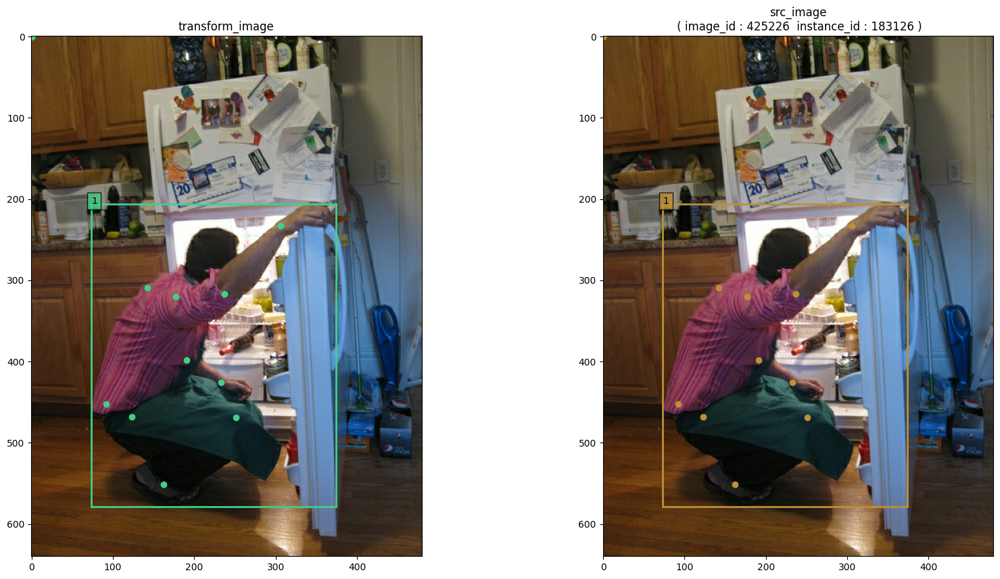

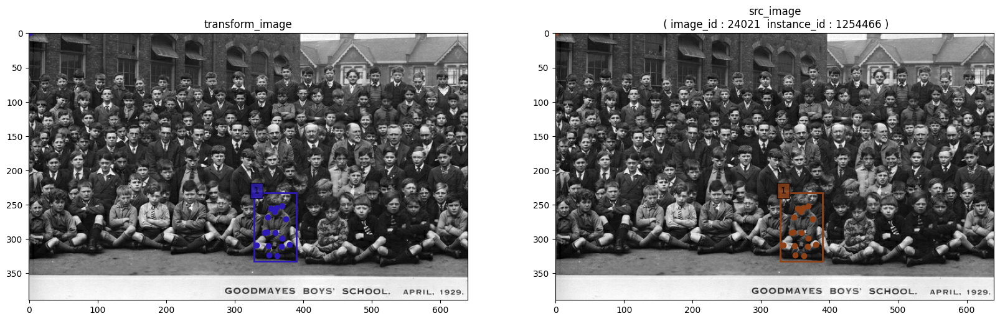

In [7]:
val_tfrec_parser.explore_samples(
    take_batch_num = 2,
    test_mode = True
)

### **<font size="5">`aic single pose`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_kps_val

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_kps_val

samples_in_tfrec : 4041 @ <file_00-4041.tfrec>
samples_in_tfrec : 4019 @ <file_01-4019.tfrec>
samples_in_tfrec : 3989 @ <file_02-3989.tfrec>
samples_in_tfrec : 3962 @ <file_03-3962.tfrec>
samples_in_tfrec : 4025 @ <file_04-4025.tfrec>
samples_in_tfrec : 4008 @ <file_05-4008.tfrec>
samples_in_tfrec : 4037 @ <file_06-4037.tfrec>
samples_in_tfrec : 3913 @ <file_07-3913.tfrec>
samples_in_tfrec : 3692 @ <file_08-3692.tfrec>
samples_in_tfrec : 3955 @ <file_09-3955.tfrec>
samples_in_tfrec : 3988 @ <file_10-3988.tfrec>
samples_in_tfrec : 3971 @ <file_11-3971.tfrec>
samples_in_tfrec : 3937 @ <file_12-3937.tfrec>
samples_in_tfrec : 3796 @ <file_13-3796.tfrec>
samples_in_tfrec : 3018 @ <file_14-3018.tfrec>
samples_in_tfrec : 3745 @ <file_15-3745.tfrec>
samples_in_tfrec : 4021 @ <file_16-4021.tfrec>

2024-04-12 09:53:57.800160: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [18]
	 [[{{node Placeholder/_0}}]]
2024-04-12 09:53:57.800459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_9' with dtype int32 and shape [12]
	 [[{{node Placeholder/_9}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([1, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- TensorSpec(shape=(1, 17, 3), dtype=tf.float32, name=None)
bboxes ----- TensorSpec(shape=(1, 4), dtype=tf.float32, name=None)
labels ----- None
src_img ----- RaggedTensorSpec(TensorShape([1, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- TensorSpec(shape=(1, 4), dtype=tf.float32, name=None)
src_labels ----- None
src_img_id ----- TensorSpec(shape=(1,), dtype=tf.int64, name=None)
src_ids ----- TensorSpec(shape=(1,), dtype=tf.int64, name=None)
src_kpts ----- TensorSpec(shape=(1, 17, 3), dtype=tf.float32, name=None)


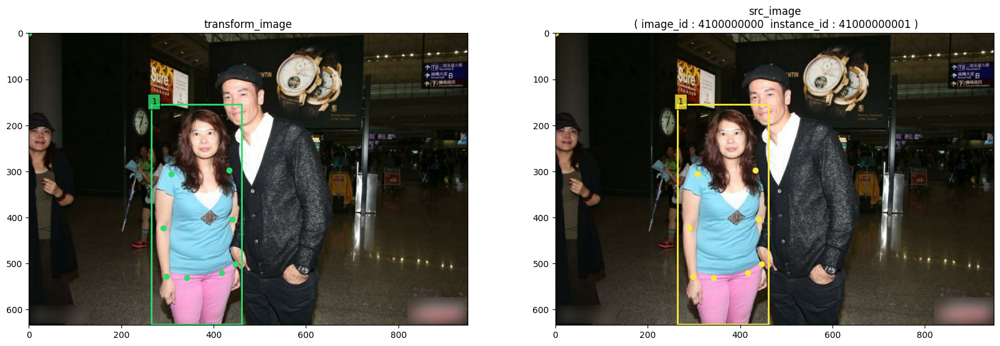

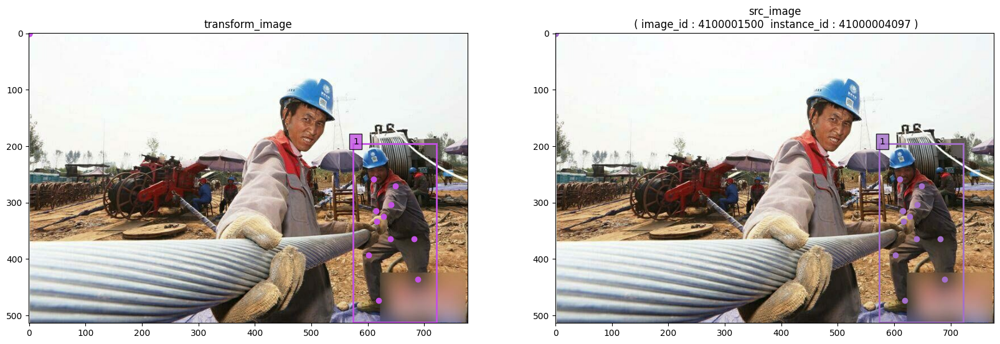

In [8]:
from lib.Registers import DATASETS
'verify whether tfrecords_dir is exist'
is_path_available(aic_val_sp_tfrec_dir)

tfrec_val_dataset = dict(
        type = 'Parser_AicSinglePoseTFRec', 
        data_root = aic_val_sp_tfrec_dir,
        pose_style = 'coco'
)
val_tfrec_parser = DATASETS.build(tfrec_val_dataset)
'option'
val_tfrec_parser.explore_samples(
    take_batch_num = 2,
    test_mode = True
)

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_kps_val



 -------- id : 41000000001-----------
image: shape - (634, 950, 3)
bbox: shape - (4,)
kps: shape - (17, 3)
image_size: shape - (2,)
bbox_format: shape - ()
meta_info: 
      src_image: (634, 950, 3)
      src_height: 634
      src_width: 950
      src_keypoints: (17, 3)
      src_bbox: (4,)
      src_num_keypoints: 8
      area: 93688.0
      category_id: 1
      id: 41000000001
      image_id: 4100000000
      iscrowd: 0
transform2src: 
      scale_xy: (2,)
      pad_offset_xy: (2,)
      bbox_lt_xy: (2,)


2024-04-11 23:40:18.537105: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_9' with dtype int32 and shape [12]
	 [[{{node Placeholder/_9}}]]
2024-04-11 23:40:18.537360: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [18]
	 [[{{node Placeholder/_0}}]]




 -------- id : 41000004097-----------
image: shape - (514, 777, 3)
bbox: shape - (4,)
kps: shape - (17, 3)
image_size: shape - (2,)
bbox_format: shape - ()
meta_info: 
      src_image: (514, 777, 3)
      src_height: 514
      src_width: 777
      src_keypoints: (17, 3)
      src_bbox: (4,)
      src_num_keypoints: 11
      area: 46768.0
      category_id: 1
      id: 41000004097
      image_id: 4100001500
      iscrowd: 0
transform2src: 
      scale_xy: (2,)
      pad_offset_xy: (2,)
      bbox_lt_xy: (2,)


 -------- id : 41000008193-----------
image: shape - (1000, 655, 3)
bbox: shape - (4,)
kps: shape - (17, 3)
image_size: shape - (2,)
bbox_format: shape - ()
meta_info: 
      src_image: (1000, 655, 3)
      src_height: 1000
      src_width: 655
      src_keypoints: (17, 3)
      src_bbox: (4,)
      src_num_keypoints: 10
      area: 245640.0
      category_id: 1
      id: 41000008193
      image_id: 4100003124
      iscrowd: 0
transform2src: 
      scale_xy: (2,)
      pad_offse

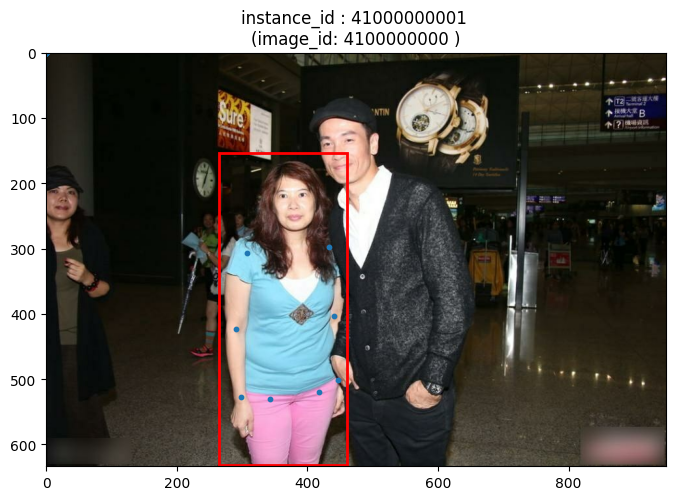

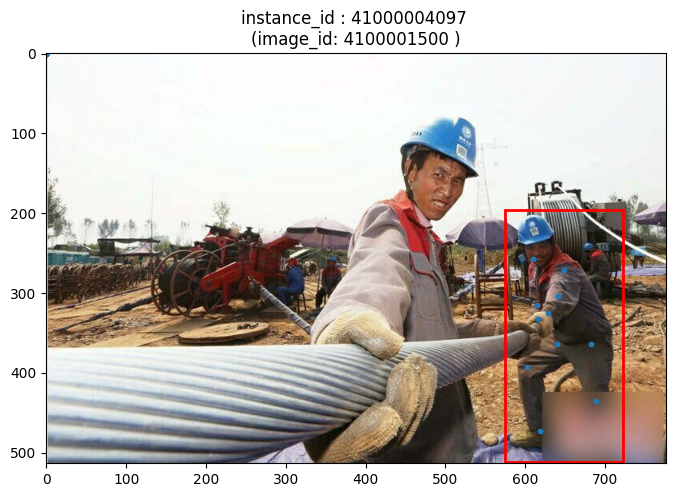

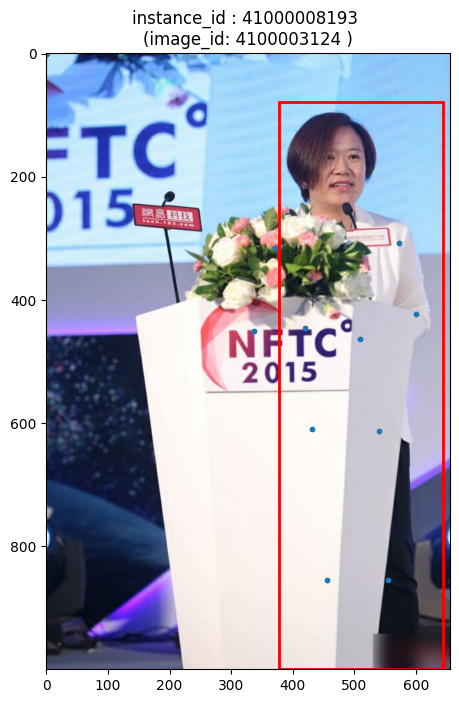

In [7]:
val_tfrec_parser.review_data_spec(3)

### **<font size="5">`coco multi poses`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val



2024-04-12 09:54:15.273984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-12 09:54:15.274253: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([1, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([1, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([1, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([1, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([1, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([1, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([1, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(1,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([1, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([1, None, 17, 3]), tf.float32, 1, tf.int64)


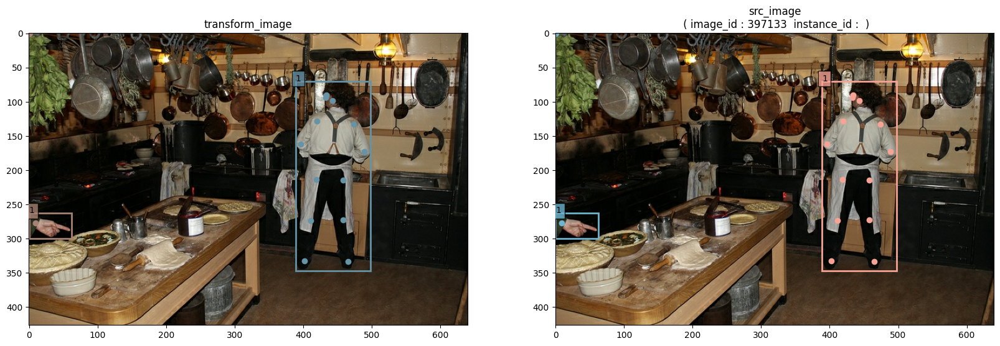

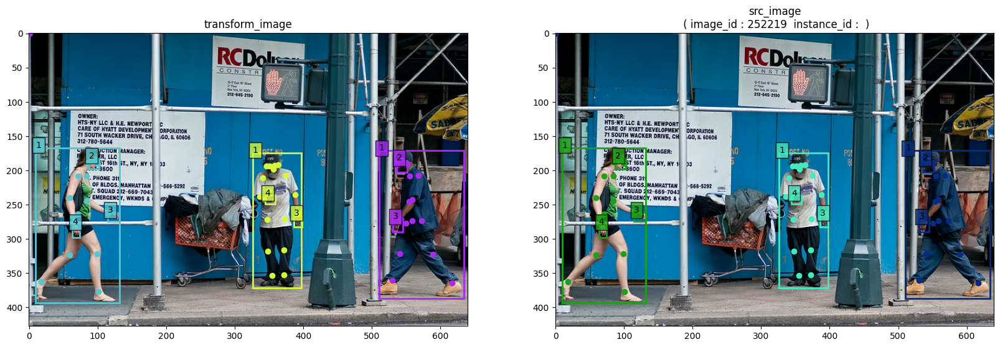

In [9]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)]
)
val_tfrec_parser = DATASETS.build(tfrec_val_dataset)

'option'
val_tfrec_parser.explore_samples(
    take_batch_num = 2,
    test_mode = True
)

In [10]:
val_tfrec_parser.review_data_spec(5, False)

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val



 -------- id : [ 200887 1218137]-----------
image: shape - (427, 640, 3)
bbox: shape - (2, 4)
labels: shape - (2,)
image_size: shape - (2,)
bbox_format: shape - ()
kps: shape - (2, 17, 3)
meta_info: 
      src_image: (427, 640, 3)
      src_height: 427
      src_width: 640
      src_bbox: (2, 4)
      area: (2,)
      src_labels: (2,)
      id: (2,)
      image_id: 397133
      iscrowd: (2,)
      src_num_keypoints: (2,)
      src_keypoints: (2, 17, 3)


 -------- id : [481918 489768 495624]-----------
image: shape - (428, 640, 3)
bbox: shape - (10, 4)
labels: shape - (10,)
image_size: shape - (2,)
bbox_format: shape - ()
kps: shape - (3, 17, 3)
meta_info: 
      src_image: (428, 640, 3)
      src_height: 428
      src_width: 640
      src_bbox: (10, 4)
      area: (3,)
      src_labels: (10,)
      id: (3,)
      image_id: 252219
      iscrowd: (3,)
      src_num_k

2024-04-12 09:54:29.748739: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-12 09:54:29.748977: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]


### **<font size="5">`aic multi poses`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_multi_poses_val

samples_in_tfrec : 5424 @ <file_03-5424.tfrec>
samples_in_tfrec : 8192 @ <file_00-8192.tfrec>
samples_in_tfrec : 8192 @ <file_01-8192.tfrec>
samples_in_tfrec : 8192 @ <file_02-8192.tfrec>
num_TotalSamples: 30000
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_multi_poses_val



2024-04-12 09:55:23.596945: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [4]
	 [[{{node Placeholder/_0}}]]
2024-04-12 09:55:23.597283: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_9' with dtype int32 and shape [12]
	 [[{{node Placeholder/_9}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([1, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([1, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([1, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([1, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([1, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([1, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([1, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(1,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([1, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([1, None, 17, 3]), tf.float32, 1, tf.int64)


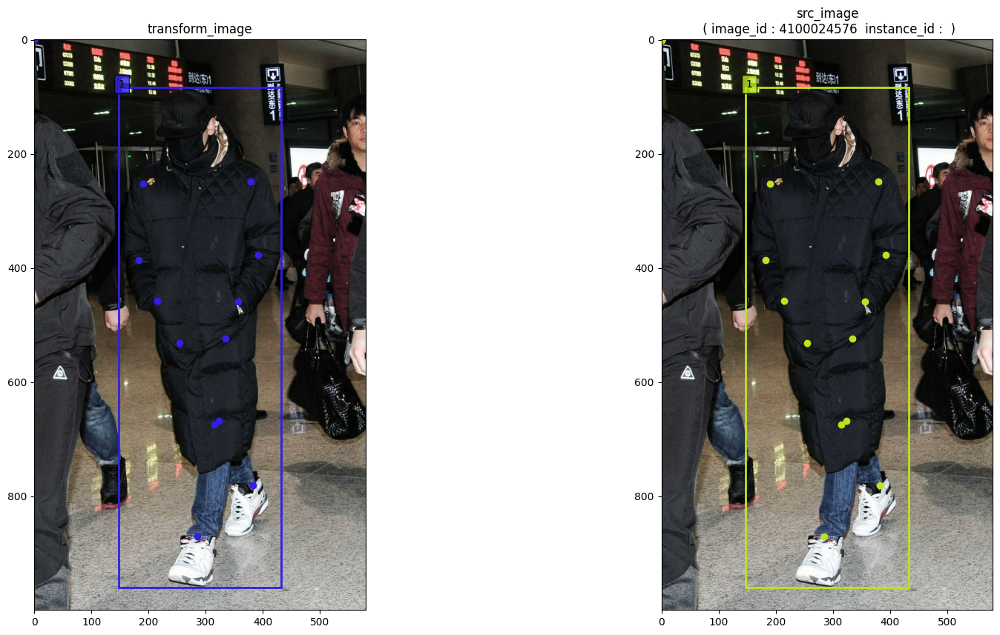

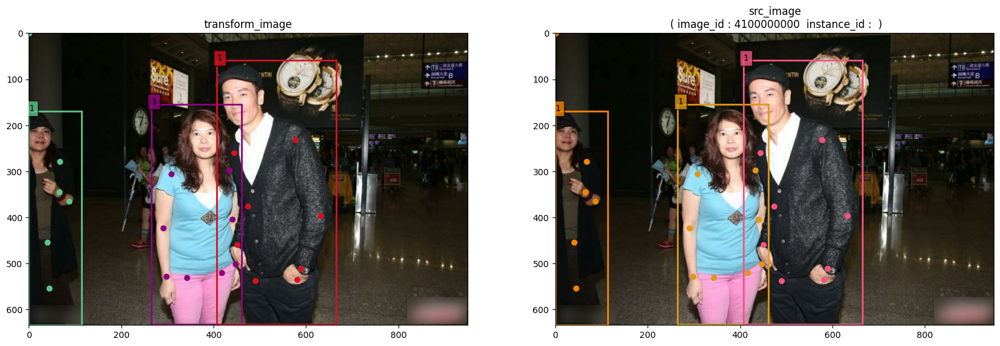

In [11]:
tfrec_val_dataset_cfg = dict(
    type = 'Parser_AicMultiPoseTFRec', 
    data_root = aic_val_mp_tfrec_dir,
    pose_style = 'coco'
)
val_tfrec_parser = DATASETS.build(tfrec_val_dataset_cfg)

# # 'option'
val_tfrec_parser.explore_samples(
    take_batch_num = 2,
    test_mode = True
)

## **<font size="6">`2-2. Example of Tasks`</font>**

### **<font size="5">`A.) Topdwon pose w/o encoder`</font>**

/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:92: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(


successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

samples_in_tfrec : 1880 @ <file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val



2024-04-14 15:00:11.153845: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'map/while/cond/cond/cond/cond_1/ones/map/while/cond/cond/strided_slice' with dtype int32 and shape [2]
	 [[{{node map/while/cond/cond/cond/cond_1/ones/map/while/cond/cond/strided_slice}}]]
2024-04-14 15:00:11.153917: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'map/while/cond/cond/cond/cond_1/ones/map/while/cond/cond/strided_slice' with dtype int32 and shape [2]
	 [[{{node map/while/cond/cond/cond/cond_1/ones/map/while/cond/cond/strided_slice}}]]
2024-04-14 15:00:12.652232: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomFlip : <lib.datasets.transforms.random_flip.RandomFlip object at 0x7feec162fc40>
< 2 >  --- RandomHalfBody : <lib.datasets.transforms.random_half_body.RandomHalfBody object at 0x7feec1659100>
< 3 >  --- RandomBBoxTransform : <lib.datasets.transforms.random_bbox_transform.RandomBBoxTransform object at 0x7fee917bc820>
< 4 >  --- RandomCutoutByKeypoints : <lib.datasets.transforms.random_cutout_by_kps.RandomCutoutByKeypoints object at 0x7fee917bcd00>
< 5 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7feec147c9d0>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([32, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- TensorSpec(shape=(32, 17, 3), dtype=tf.float32, name=None)
bboxes ----- TensorSpec(shape

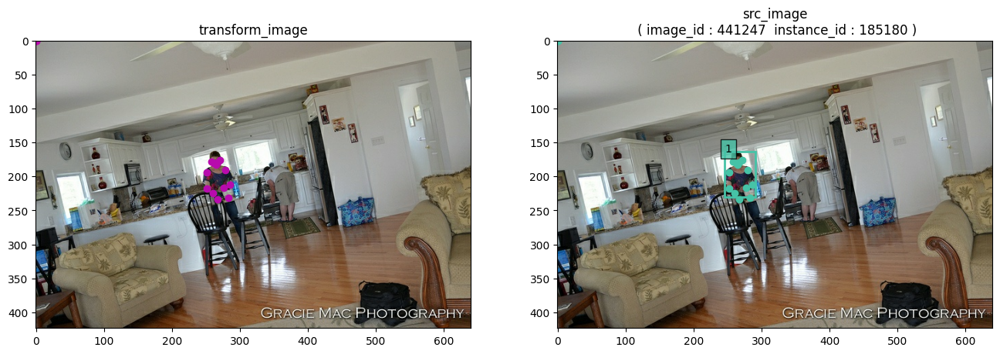

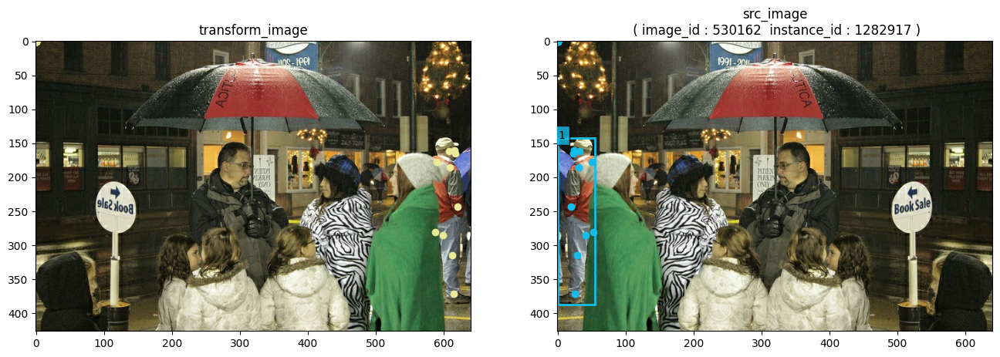

In [11]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoSinglePoseTFRec', 
    data_root = val_sp_tfrec_dir,
)

flip_cfg = dict(
    type='RandomFlip',
    prob=0.5,
    kps_index_flip = [0, 2, 1, 4, 3, 6, 5, 8, 7, 10, 9, 12, 11, 14, 13, 16, 15]
)
halfbody_cfg = dict(
    type='RandomHalfBody',
    prob=0.5, 
    upper_prioritized_prob= 0.7,
    padding = 1.5,
    min_total_keypoints = 9, 
    min_upper_keypoints = 4,
    min_lower_keypoints = 4
)
bbox_cfg = dict(
    type='RandomBBoxTransform',  
    shift_factor = 0.16, 
    shift_prob = 0.5, 
    scale_factor = (0.75, 1.25), 
    scale_prob = 0.5 ,
)
# bbox_cfg = dict(
#     type='RandomBBoxTransform',  
#     shift_factor = 0.16, 
#     shift_prob = 0.5, 
#     scale_factor = (0.75, 1.25), 
#     scale_prob = 0.5 ,
#     #test_mode = False
# )
kpsdrop_cfg = dict(
    type='RandomCutoutByKeypoints',   
    base_mask_ratio = 0.05,
    mask_scale_factor = (0.8, 1.2),
    min_bbox_area = 64.*64.,
    prob=0.2, 
    drop_joints_indices=[5,6,7,8,11,12],
    random_mask_color=False, 
    test_mode =False
)
affine_cfg = dict(
    type='TopdownAffine',
    is_train = True, 
    test_mode = False,   
    do_clip = True,      
    keep_bbox_aspect_prob = 0.5,
    rotate_prob = 0.5,
    shear_prob = 0.0,
    MaxRot_deg=30., 
    MaxShear_deg=15.
)

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = BATCH_SIZE,
    prefetch_size = PREFETCH_SIZE,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [flip_cfg, halfbody_cfg, bbox_cfg, kpsdrop_cfg],
    codec = None,
    ensure_to_tensor = False,
    parallel_iterations = CV_TRANS_PARALLEL_ITERS,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0],
        plot_transformed_bbox=False,
    )
)
#---------------------------------------------------------------------
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_train_dataset = tfds_builder.GenerateTargets(    
    test_mode = False, 
    unpack_x_y_sample_weight= False, 
    ds_weights = None
)
#--------------------------------------------------------------------
# 'JUST TO REVIEW TRANSFORM RESESULTS'
# tfds_builder.get_pipeline_cfg()
'JUST TO REVIEW TRANSFORM RESESULTS'
tfds_builder.explore_samples(
    take_batch_num = 2,
)


In [29]:
    
def compute_signature(
                          data, 
                          fn_output_signature = {}):
        """
        recursive method to find all output signatures for tf.map_fn
        """
        for key, val in data.items():
            if isinstance(val, dict):
                sub_fn_output_signature = compute_signature(val,{})
                fn_output_signature[key] = sub_fn_output_signature
            else:
                #print(key, "-----", tf.type_spec_from_value(val[...]))
                if isinstance(val, tf.RaggedTensor):
                    TensorSpec = tf.type_spec_from_value(val)
                    if TensorSpec.ragged_rank>=2 :
                        'image'
                        fn_output_signature[key] = tf.type_spec_from_value(val[0,...])
                    else:
                        'bboxes, labels, kps'
                        fn_output_signature[key] = tf.RaggedTensorSpec(
                                                shape=val.shape[1:],
                                                ragged_rank=0,
                                                dtype=TensorSpec.dtype
                        )  
                elif isinstance(val, tf.Tensor):   
                    TensorSpec = tf.type_spec_from_value(val[0,...])
                    fn_output_signature[key] = TensorSpec   
                else:
                    raise TypeError(
                        "type of value in data(dict) must be tf.Tensor or tf.RaggedTensor"
                         f", but got {type(val)} for key = '{key}")   
        return  fn_output_signature
for sample in batch_train_dataset.take(1):
    fn_output_signature = tf.nest.map_structure(
            lambda x : tf.type_spec_from_value(x[0]), sample
    )
    tf.print(fn_output_signature)

    fn_output_signature = compute_signature(
        sample, {}
    )
    tf.print(fn_output_signature)  
    pass











2024-04-14 15:12:10.537924: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_22' with dtype float
	 [[{{node Placeholder/_22}}]]
2024-04-14 15:12:10.538350: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_22' with dtype float
	 [[{{node Placeholder/_22}}]]


{'bbox': TensorSpec(shape=(4,), dtype=tf.float32, name=None),
 'bbox_format': TensorSpec(shape=(), dtype=tf.string, name=None),
 'image': RaggedTensorSpec(TensorShape([640, None, 3]), tf.uint8, 1, tf.int64),
 'image_size': TensorSpec(shape=(2,), dtype=tf.int32, name=None),
 'kps': TensorSpec(shape=(17, 3), dtype=tf.float32, name=None)}
{'bbox': TensorSpec(shape=(4,), dtype=tf.float32, name=None),
 'bbox_format': TensorSpec(shape=(), dtype=tf.string, name=None),
 'image': RaggedTensorSpec(TensorShape([640, None, 3]), tf.uint8, 1, tf.int64),
 'image_size': TensorSpec(shape=(2,), dtype=tf.int32, name=None),
 'kps': TensorSpec(shape=(17, 3), dtype=tf.float32, name=None)}


### **<font size="5">`B. Topdwon pose with Encoder`</font>**

### **<font size="5">`C. Bottomup pose`</font>**

### **<font size="5">`Bottomup pose det (coco dataset)`</font>**

register : <tfds_pipeline>  init ...................from internal libs


 All Modules of registry < tfds_pipeline >have been automatically imported from lib.datasets

--------------register : <tfds_pipeline>  Update Done-----from internal libs

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

Instructions for updating:
Use `tf.data.Dataset.ignore_errors` instead.


register : <transforms>  init ...................from internal libs


 All Modules of registry < transforms >have been automatically imported from lib.datasets.transforms

--------------register : <transforms>  Update Done-----from internal libs



/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:92: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(
2024-04-15 15:17:29.169114: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-04-15 15:17:29.169146: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:260: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")
2024-04-15 


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomPadImageResize : <lib.datasets.transforms.img_resize.RandomPadImageResize object at 0x7f7c091f30a0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7f7c0925faf0>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(T

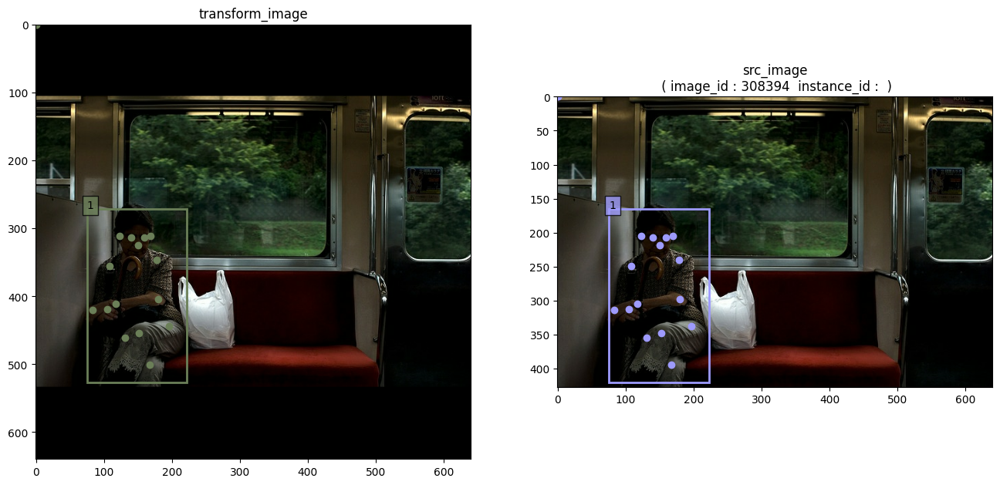

In [6]:
tfrec_val_dataset_cfg = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = False,
    sel_kpt_idx  =[i for i in range(17)],
    pose_style = 'coco'
)

# from lib.datasets.transforms import RandomPadImageResize
resize_cfg = dict(
    type = 'RandomPadImageResize',
    target_size = (640,640),
    pad_types  = ['center'],
    pad_val = 0,
    use_udp  = True,
)
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset_cfg],
    augmenters = [resize_cfg],  #[IdendityTest_cfg , mosaic] #resize_cfg
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=False, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
'JUST TO REVIEW TRANSFORM RESESULTS'
tfds_builder.explore_samples(take_batch_num=1)



In [11]:
a = tf.__version__
print(a)
a = "2.10.0"
if a > "2.10.1":
    print('ok')

2.12.0


In [12]:
# tensor = tf.ragged.constant([[1, 2], [3], [4, 5, 6]])
# print( tf.type_spec_from_value( tensor) )
# # (2, None, 2)
# tensor = tf.ragged.constant([[[1,1], [2,2]], [[1,1],[2,2],[3,3]]])
# print( tf.type_spec_from_value( tensor[0]) )




RaggedTensorSpec(TensorShape([3, None]), tf.int32, 1, tf.int64)
RaggedTensorSpec(TensorShape([2, None]), tf.int32, 1, tf.int64)


In [27]:
for sample in batch_dataset.take(1):


    print(sample.keys())
    TensorSpecs_dict = tf.nest.map_structure(
        lambda x : tf.type_spec_from_value(x) , sample
    )
    tf.print(TensorSpecs_dict)
    tf.print( tf.nest.flatten(TensorSpecs_dict) )



    cond = all([isinstance(spec,(tf.RaggedTensorSpec,tf.TensorSpec)) for spec in tf.nest.flatten(TensorSpecs_dict)])
    print(cond)
    #print([isinstance(spec,(tf.RaggedTensorSpec,tf.TensorSpec)) for spec in  TensorSpecs_dict.values()  ])
    if not all([isinstance(spec,(tf.RaggedTensorSpec,tf.TensorSpec)) for spec in tf.nest.flatten(TensorSpecs_dict)]):
        #print(TensorSpecs.values())
        print("fail")
    
    # spec = tf.type_spec_from_value( sample['image'])
    # print(isinstance(spec,tf.RaggedTensorSpec))
    # print(tf.type_spec_from_value( sample['image']))
    # spec = tf.type_spec_from_value( sample['image_size'])
    # print(isinstance(spec,tf.RaggedTensorSpec))
    # if not isinstance(spec,(tf.RaggedTensorSpec,tf.TensorSpec)):
    #     print("!!!!!!!!!!!!!!!!!!")
    #print(tf.type_spec_from_value( sample['image_size']))
    # image = sample['image'][0]
    # TensorSpec = tf.type_spec_from_value( sample['image'])
    # print(type(TensorSpec))
    # print( TensorSpec.ragged_rank)
    # print( TensorSpec.shape[1:])
    # print( sample.keys() )
    # print(tf.type_spec_from_value( sample['image_size']))
    # image_size = sample['image_size'][0]
    # TensorSpec = tf.type_spec_from_value( image_size)
    # print(TensorSpec)
    # tf.RaggedTensorSpec(tf.TensorSpec
    #                                             shape=val.shape[1:],
    #                                             ragged_rank=0,
    #                                             dtype=TensorSpec.dtype
    # print(image.ragged_rank)
    # bbox = sample['bbox'][0]
    # print(bbox.ragged_rank)
    #print(tf.type_spec_from_value(image))

2024-04-15 13:04:23.107394: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-15 13:04:23.107732: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]


dict_keys(['image', 'bbox', 'labels', 'image_size', 'bbox_format', 'kps'])
{'bbox': RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64),
 'bbox_format': TensorSpec(shape=(4,), dtype=tf.string, name=None),
 'image': RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64),
 'image_size': TensorSpec(shape=(4, 2), dtype=tf.int32, name=None),
 'kps': RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64),
 'labels': RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)}
[RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64),
 TensorSpec(shape=(4,), dtype=tf.string, name=None),
 RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64),
 TensorSpec(shape=(4, 2), dtype=tf.int32, name=None),
 RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64),
 RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)]
True


### **<font size="5">`Bottomup pose det (aic dataset)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_multi_poses_val

samples_in_tfrec : 5424 @ <file_03-5424.tfrec>
samples_in_tfrec : 8192 @ <file_00-8192.tfrec>
samples_in_tfrec : 8192 @ <file_01-8192.tfrec>
samples_in_tfrec : 8192 @ <file_02-8192.tfrec>
num_TotalSamples: 30000
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomPadImageResize : <lib.datasets.transforms.img_resize.RandomPadImageResize object at 0x7fb0d3248520>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fb0d32768b0>
--------------------------------------------------------------------------------



2024-04-12 10:14:03.432405: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_9' with dtype int32 and shape [12]
	 [[{{node Placeholder/_9}}]]
2024-04-12 10:14:03.432779: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_9' with dtype int32 and shape [12]
	 [[{{node Placeholder/_9}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)


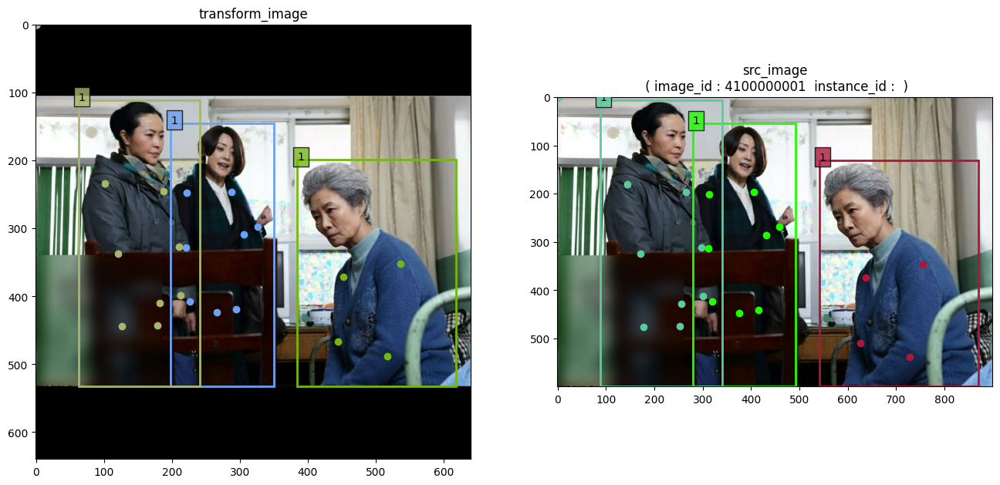

In [18]:
tfrec_val_dataset_cfg = dict(
    type = 'Parser_AicMultiPoseTFRec', 
    data_root = aic_val_mp_tfrec_dir,
    pose_style = 'coco'
)

resize_cfg = dict(
    type = 'RandomPadImageResize',
    target_size = (640,640),
    pad_types  = ['center'],
    pad_val = 0,
    use_udp  = True,
)
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset_cfg],
    augmenters = [resize_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=False, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
'JUST TO REVIEW TRANSFORM RESESULTS'
tfds_builder.explore_samples(take_batch_num=1)

### **<font size="5">`HumanDet det(coco dataset)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- ImageResize : <lib.datasets.transforms.img_resize.ImageResize object at 0x7fb081eff9a0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fb0c1102310>
--------------------------------------------------------------------------------



2024-04-12 10:14:49.178918: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_20' with dtype int32 and shape [2]
	 [[{{node Placeholder/_20}}]]
2024-04-12 10:14:49.179274: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)


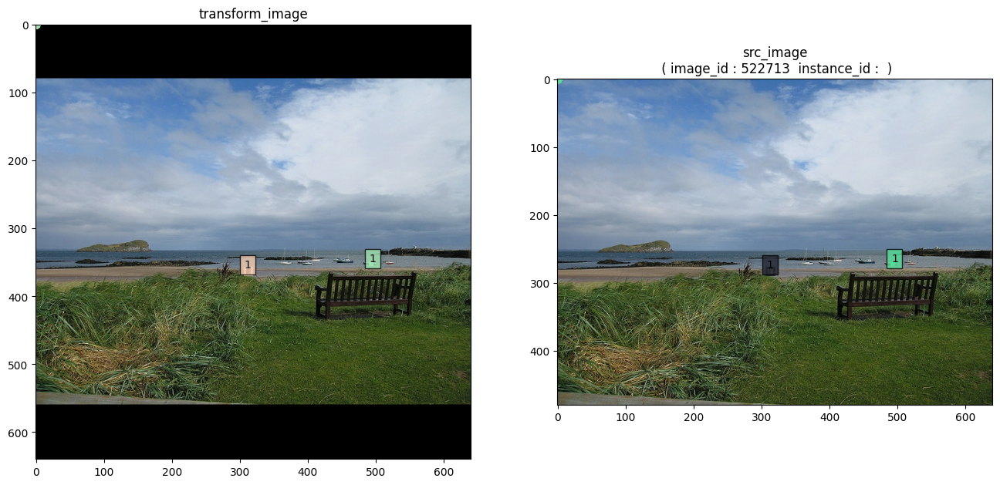

In [19]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)],
    pose_style = 'coco'
)
img_resize_cfg = dict(
    type = 'ImageResize',
    resized_shape = (640,640),
    symmetric_padding_prob  = 0.5, 
    name = 'img_resize_layer'
)
test_dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [img_resize_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)
tfds_builder = DATASETS.build(
    copy.deepcopy(test_dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
# tfds_builder.get_pipeline_cfg() 
# batch_id = 0
'JUST TO REVIEW TRANSFORM RESESULTS'
tfds_builder.explore_samples(take_batch_num=1)

### **<font size="6">`Explore loaded samples from  pasrsed TFRecData`</font>**

## **<font size="6">`2-3. Multi datasets (coco +aic )`</font>**

/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:92: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(


successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

samples_in_tfrec : 1880 @ <file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/AIC/tfrecords_kps_val

samples_in_tfrec : 4041 @ <file_00-4041.tfrec>
samples_in_tfrec : 4019 @ <file_01-4019.tfrec>
samples_in_tfrec : 3989 @ <file_02-3989.tfrec>
samples_in_tfrec : 3962 @ <file_03-3962.tfrec>
samples_in_tfrec : 4025 @ <file_04-4025.tfrec>
samples_in_tfrec : 4008 @ <file_05-4008.tfrec>
samples_in_tfrec : 4037 @ <file_06-4037.tfrec>
samples_in_tfrec : 3913 @ <file_07-3913.tfrec>
samples_in_tfrec : 3692 @ <file_08-3692.tfrec>
samples_in_tfrec : 3955 @ <file_09-3955.tfrec>
samples_in_tfrec : 3988 @ <file_10-3988.tfrec>
samples_in_tfrec : 3971 @ <file_11-3971.tfrec>
samples_in_tfrec : 3937 @ <file_12-3937.tfrec>
samples_in_t

/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:260: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")
2024-04-12 11:29:06.538138: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_42' with dtype float
	 [[{{node Placeholder/_42}}]]
2024-04-12 11:29:06.538750: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_19' with dtype string and shape [18]
	 [[{{node Placeholder/_19}}]]



 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x7fb0d1a2f3a0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fb0a1303a60>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([16, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)
bboxes ----- TensorSpec(shape=(16, 4), dtype=tf.float32, name=None)
labels ----- None
src_img ----- RaggedTensorSpec(TensorShape([16, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- TensorSpec(shape=(16, 4), dtype=tf.float32, name=None)
src_labels ----- None
src_img_id ----- TensorSpec(shape=(16,), dtype=tf.int64, name=None)
src_ids ----- TensorSpec(shape=(16,), dtype=tf.int

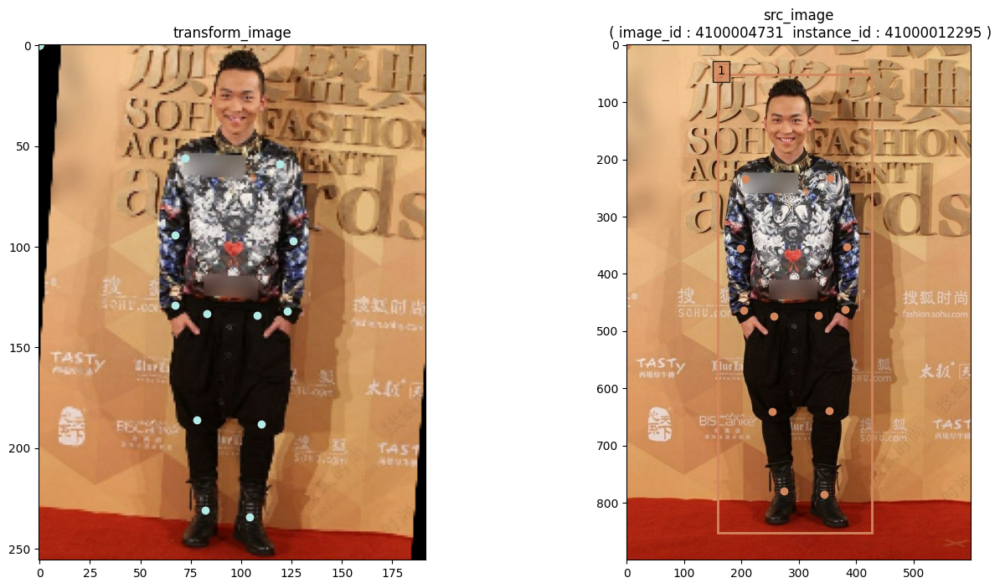

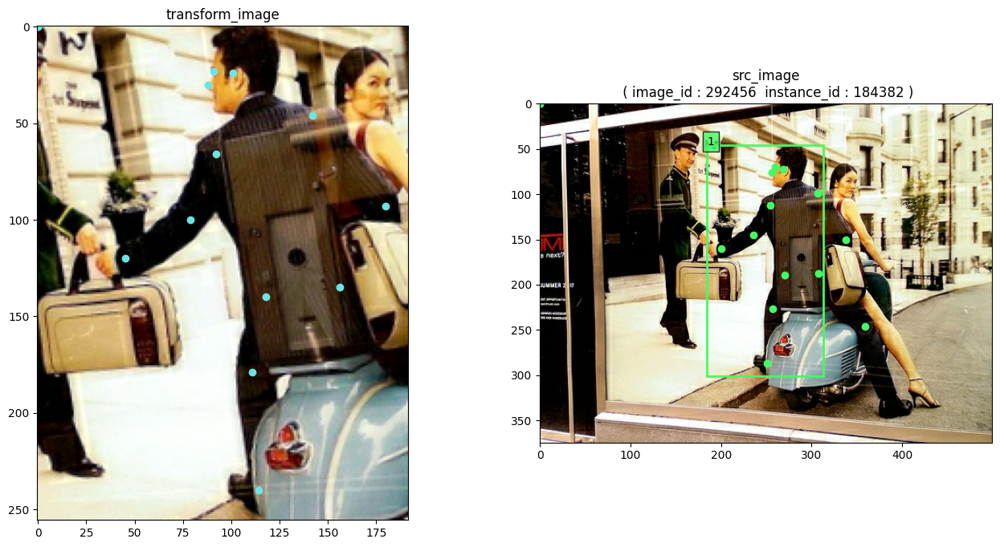

In [26]:
coco_tfrec_val_dataset_cfg = dict(
    type = 'Parser_CocoSinglePoseTFRec', 
    data_root = val_sp_tfrec_dir,
)
aic_tfrec_val_dataset_cfg = dict(
    type = 'Parser_AicSinglePoseTFRec', 
    data_root = aic_val_sp_tfrec_dir,
    pose_style = 'coco'
)

affine_cfg = dict(
    type = 'TopdownAffine',
    is_train = True, 
    test_mode = False,         
    keep_bbox_aspect_prob = 0.0,
    rotate_prob = 1.0,
    shear_prob = 1.0,
    MaxRot_deg=30., 
    MaxShear_deg=10.
)

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 16,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [coco_tfrec_val_dataset_cfg, aic_tfrec_val_dataset_cfg],
    augmenters = [affine_cfg],
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0],
        plot_transformed_bbox=False,
    )
)

tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_train_dataset = tfds_builder.GenerateTargets(    
    test_mode = False, 
    unpack_x_y_sample_weight= False, 
    ds_weights = None
)
'JUST TO REVIEW TRANSFORM RESESULTS'
tfds_builder.explore_samples(
    take_batch_num = 2,
)


In [27]:
tfds_builder.ds_weights

[0.0778606587891406, 0.9221393412108594]

# **<font size="7">`3. Transforms  `</font>**

## **<font size="6">`3-1. BaseCVTransformsLayer  `</font>**

## **<font size="6">`3-2. Image Resize Family  `</font>**


### **<font size="5">`a. Rnadom ImgPadResize`</font>**

register : <tfds_pipeline>  init ...................from internal libs


 All Modules of registry < tfds_pipeline >have been automatically imported from lib.datasets

--------------register : <tfds_pipeline>  Update Done-----from internal libs

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

Instructions for updating:
Use `tf.data.Dataset.ignore_errors` instead.


register : <transforms>  init ...................from internal libs


 All Modules of registry < transforms >have been automatically imported from lib.datasets.transforms

--------------register : <transforms>  Update Done-----from internal libs



/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:92: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(
2024-04-13 09:56:54.458817: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-04-13 09:56:54.458851: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:260: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")
2024-04-13 


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomPadImageResize : <lib.datasets.transforms.img_resize.RandomPadImageResize object at 0x7f8c531f2700>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7f8c68a79160>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(T

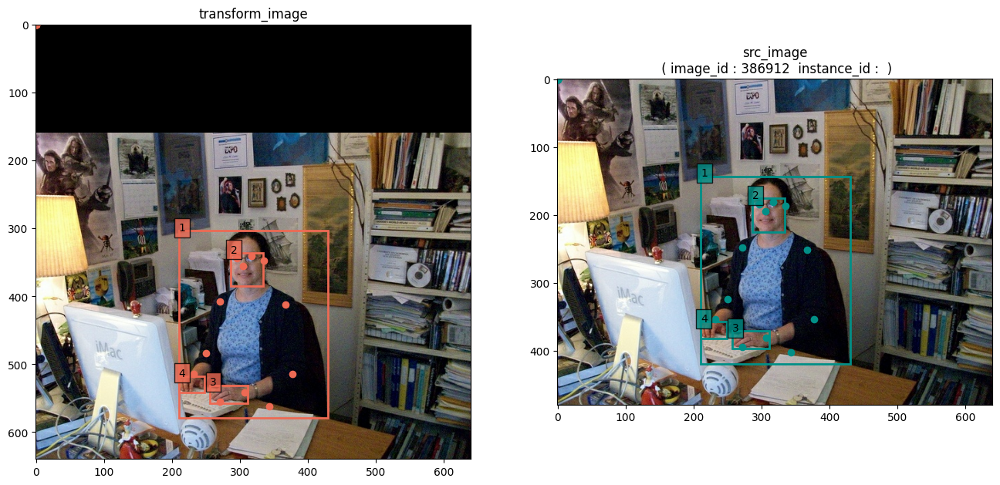

In [6]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)],
    pose_style = 'coco'
)

resize_cfg = dict(
    type = 'RandomPadImageResize',
    target_size = (640,640),
    pad_types  = ['lt', 'rt','lb', 'rb', 'center'],   #SUPPORT_METHODS = ['lt', 'rt','lb', 'rb', 'center']
    pad_val = 0,
    use_udp  = True,
)

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [resize_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)

tfds_builder.explore_samples(take_batch_num=1)

### **<font size="5">`b. TopdownAffine (topdown)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

samples_in_tfrec : 1880 @ <file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x7fb0c11cbf10>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fb0c1134790>
--------------------------------------------------------------------------------



2024-04-12 11:49:33.590258: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]
2024-04-12 11:49:33.590682: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_22' with dtype float
	 [[{{node Placeholder/_22}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([16, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)
bboxes ----- TensorSpec(shape=(16, 4), dtype=tf.float32, name=None)
labels ----- None
src_img ----- RaggedTensorSpec(TensorShape([16, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- TensorSpec(shape=(16, 4), dtype=tf.float32, name=None)
src_labels ----- None
src_img_id ----- TensorSpec(shape=(16,), dtype=tf.int64, name=None)
src_ids ----- TensorSpec(shape=(16,), dtype=tf.int64, name=None)
src_kpts ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)


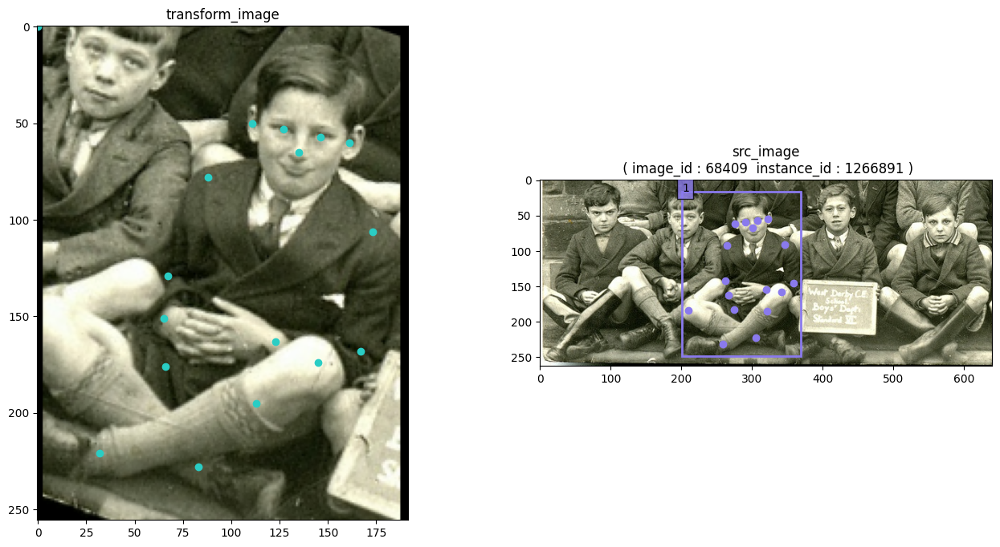

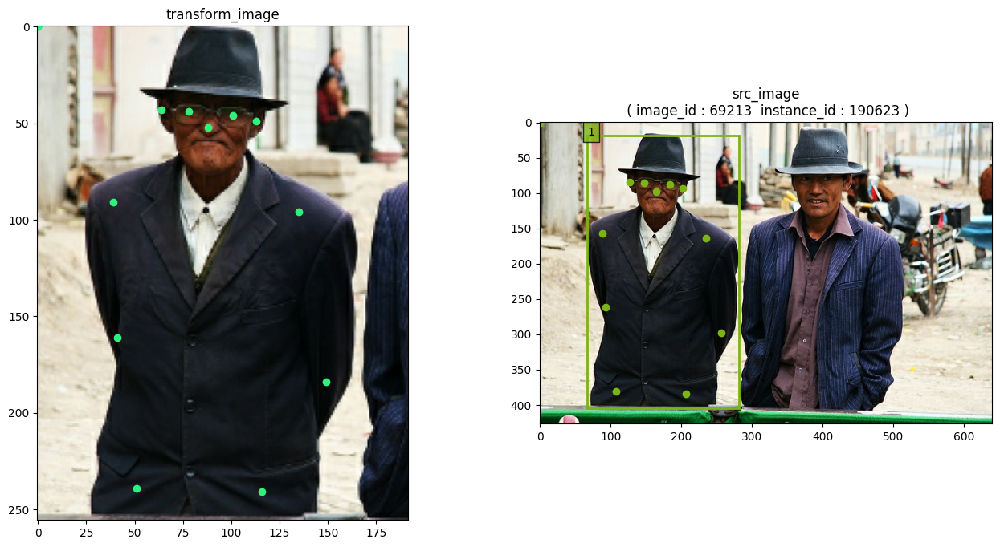

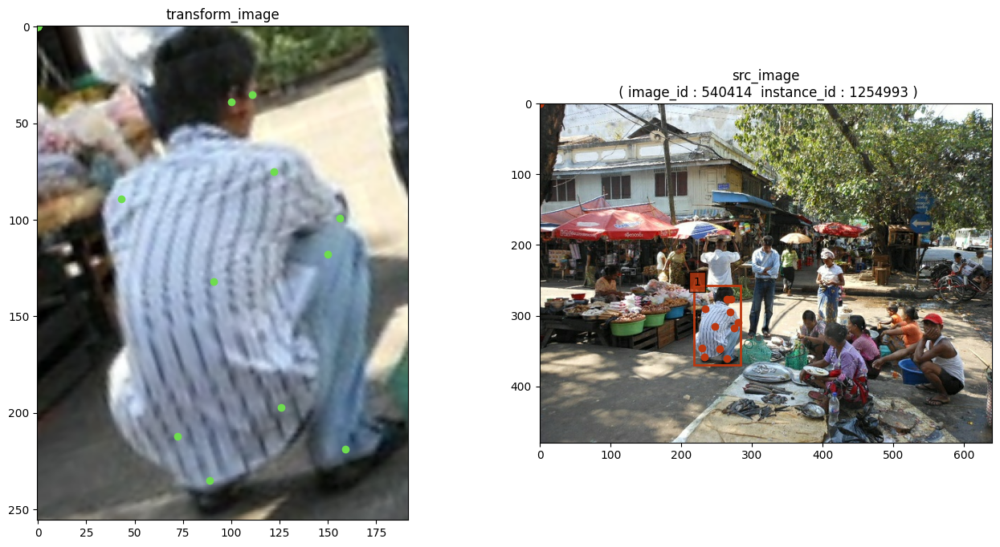

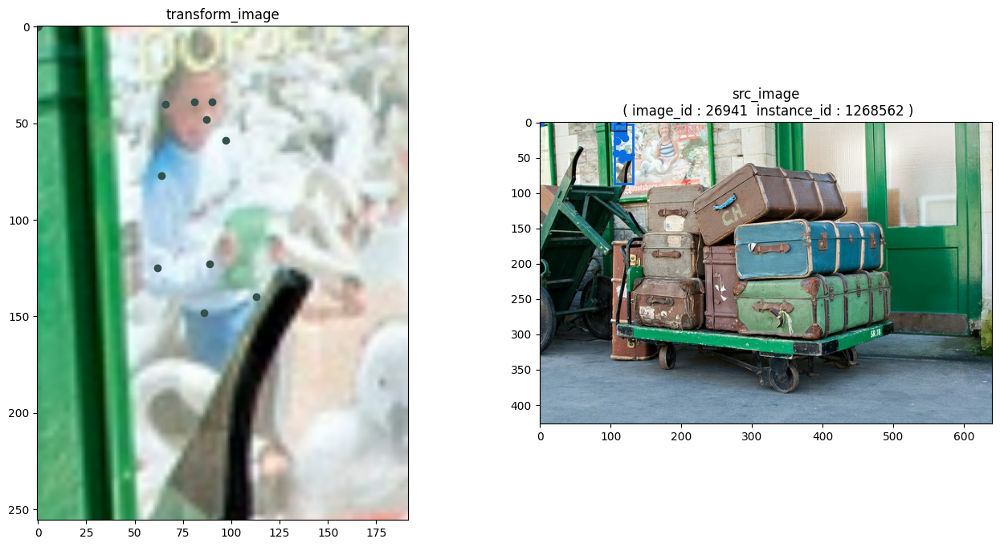

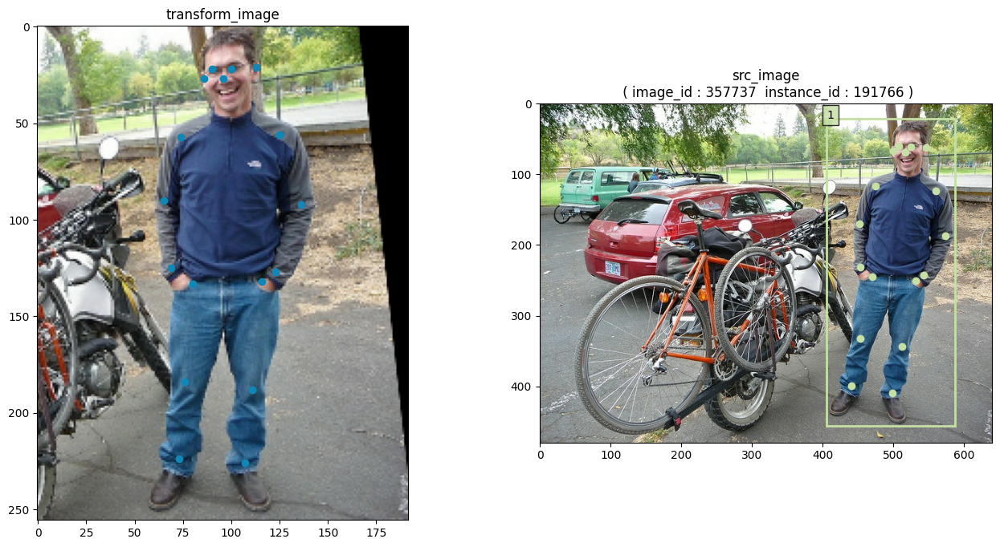

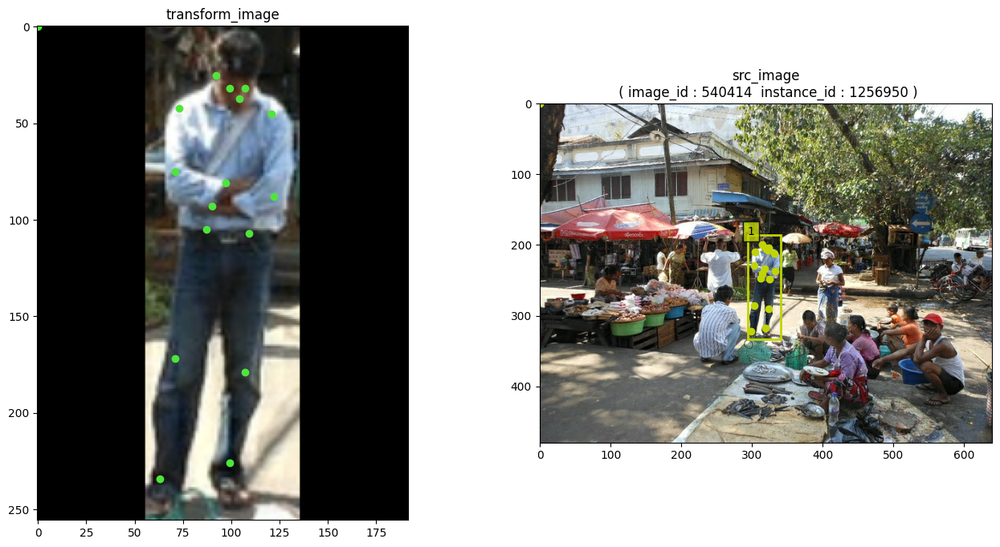

In [33]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoSinglePoseTFRec', 
    data_root = val_sp_tfrec_dir,
)
affine_cfg = dict(
    type = 'TopdownAffine',
    is_train = True, 
    test_mode = False,         
    keep_bbox_aspect_prob = 0.5,
    rotate_prob = 0.5,
    shear_prob = 0.2,
    MaxRot_deg = 30., 
    MaxShear_deg = 10.
)
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 16,
    prefetch_size = 16,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [affine_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0,1,2],
        plot_transformed_bbox=False, #topdown : no bbox after affine transform
    )
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
tfds_builder.explore_samples(
    take_batch_num = 2
)

In [34]:
# tf_matAffine_3x3 = tf.eye(3, dtype=tf.float16)

# tf_trans_inv = tf.linalg.inv(
#     tf.cast(tf_matAffine_3x3, dtype=tf.float16)
# )

print(" tensorflow version:",tf.__version__)
tf.__version__ > '2.10.1'

 tensorflow version: 2.10.0


False

In [34]:
tfds_builder.execution_time(take_batch_num=10)

2024-04-12 11:51:09.329059: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_21' with dtype float
	 [[{{node Placeholder/_21}}]]
2024-04-12 11:51:09.329616: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_21' with dtype float
	 [[{{node Placeholder/_21}}]]


avg execution time (s): 0.6492565


### **<font size="5">`c. RandomAffine`</font>**

/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:92: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(


successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val



/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:260: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")
2024-04-12 12:47:17.158094: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-12 12:47:17.158480: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomAffine : <lib.datasets.transforms.random_affine.RandomAffine object at 0x7fb0c0ffdac0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fb069115f70>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4

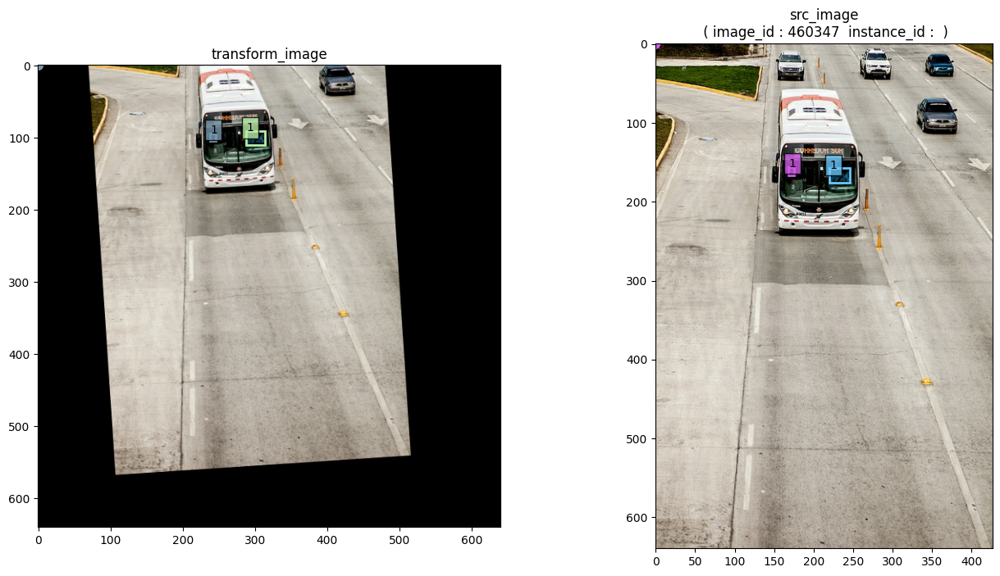

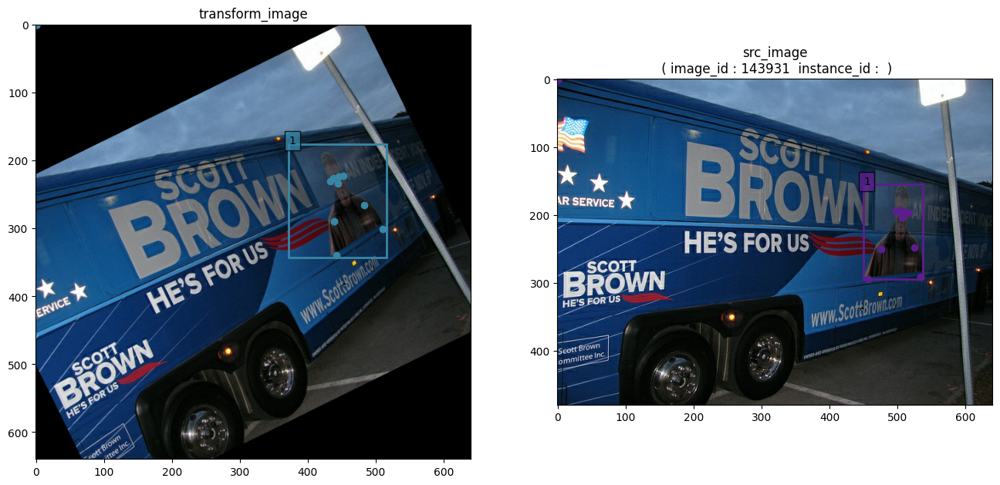

In [35]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)],
    pose_style = 'coco'
)

rand_affine_cfg =  dict(
    type = 'RandomAffine',
    target_size =(640,640),
    fill_value = 0,
    interpolation  = "bilinear",
    max_rotate_degree = 30.,
    max_translate_ratio = 0.1,
    max_shear_degree  = 0.,
    scaling_ratio_range = (0.95, 1.05),
    rotate_shear_along_with_img_center = True,
    align_to_img_center = True
)

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [rand_affine_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
    
)
#--------------------------------------------------------------     
tfds_builder = DATASETS.build(copy.deepcopy(dataloader_cfg))
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)


tfds_builder.explore_samples(
    take_batch_num = 2
)

### **<font size="5">`d. Mosaic (New) `</font>**

/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:92: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(


successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val



/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:260: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")



 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- Mosaic : <lib.datasets.transforms.mosaic.Mosaic object at 0x7fb094b42940>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fb0711bf940>
--------------------------------------------------------------------------------


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- Mosaic : <lib.datasets.transforms.mosaic.Mosaic object at 0x7fb094b42940>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fb0711bfc10>
--------------------------------------------------------------------------------



2024-04-12 16:03:53.567936: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_20' with dtype float and shape [2]
	 [[{{node Placeholder/_20}}]]
2024-04-12 16:03:53.568326: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_20' with dtype float and shape [2]
	 [[{{node Placeholder/_20}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- TensorSpec(shape=(16, 640, 640, 3), dtype=tf.uint8, name=None)
kpts ----- RaggedTensorSpec(TensorShape([16, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([16, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([16, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([16, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([16, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([16, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(16,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([16, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([16, None, 17, 3]), tf.float32, 1, tf.int64)


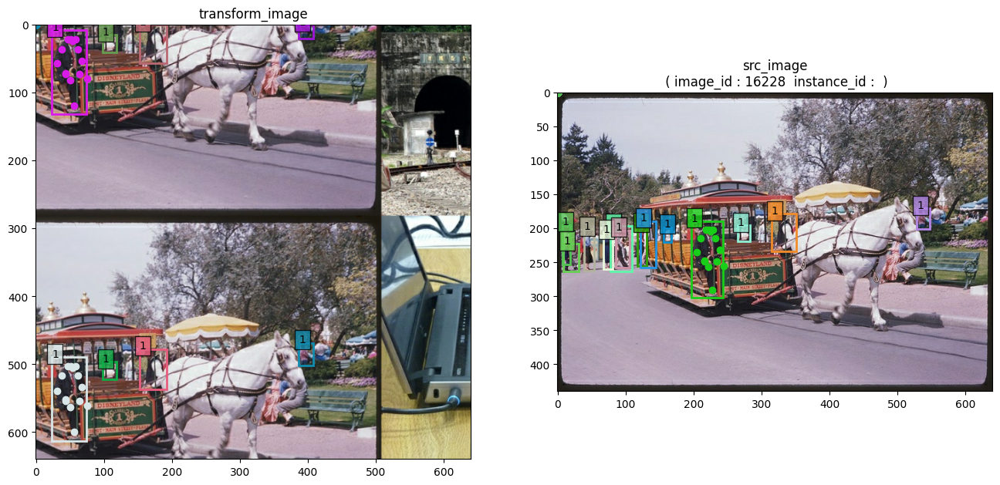

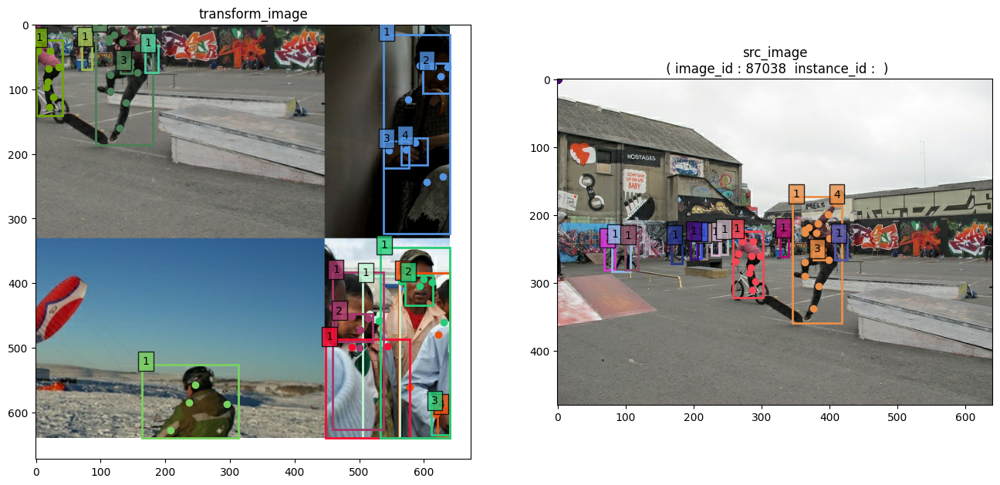

In [36]:

#(need to verify  ops is based on center of image) 
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)],
    pose_style = 'coco'
)

#[i for i in range(17)] / []
import copy
from lib.Registers import DATASETS
from datetime import datetime

mosaic = dict( 
    type  = 'Mosaic',
    target_size = (640,640),
    interpolation = 'bilinear',
    center_ratio_range = (0.75, 1.25),
    scaling_ratio_range= (0.75, 1.25),
    num_used_kps = 17,
    img_padding_val = 0,
    label_padding_val =  0,
    pose_obj_label_id  = 1,
    min_bbox_area = 0., #4096./2,
    use_affine_transform= True,
    prob = 0.
)
test_dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 16,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [mosaic],  #[IdendityTest_cfg , mosaic]
    codec = None,
     vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
    
)
tfds_builder = DATASETS.build(
    copy.deepcopy(test_dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
tfds_builder.get_pipeline_cfg() 


tfds_builder.explore_samples(
    take_batch_num = 2
)


### **<font size="5">`e. ImgPadResize`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- ImageResize : <lib.datasets.transforms.img_resize.ImageResize object at 0x7fbc214cce80>
--------------------------------------------------------------------------------


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- ImageResize : <lib.datasets.transforms.img_resize.ImageResize object at 0x7fbc214cce80>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fbc50db4940>
--------------------------------------------------------------------------------



2024-04-12 23:33:48.232506: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-12 23:33:48.232863: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)


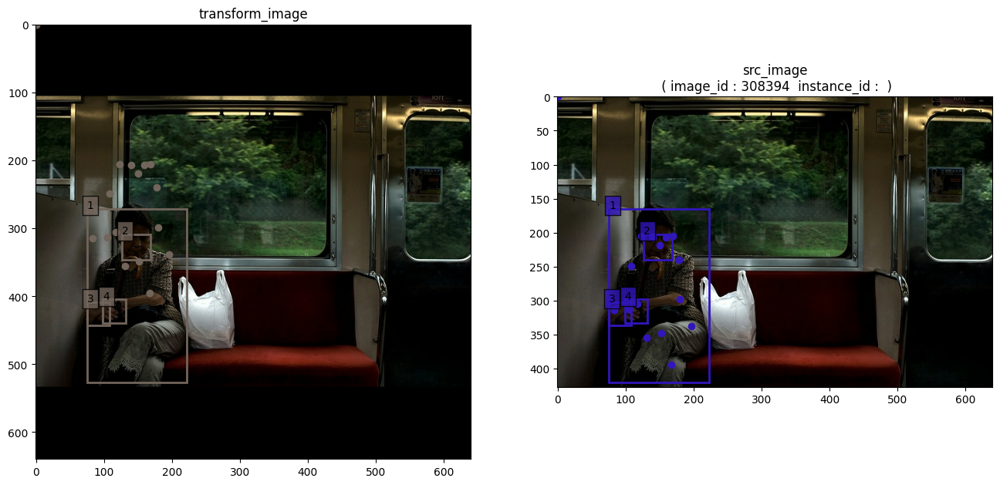

In [13]:

img_resize_cfg = dict(
    type = 'ImageResize',
    resized_shape = (640,640),
    symmetric_padding_prob  = 1.0, 
    name = 'img_resize_layer'
)
test_dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [img_resize_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)
tfds_builder = DATASETS.build(
    copy.deepcopy(test_dataloader_cfg)
)
# batch_dataset = tfds_builder.GenerateTargets(
#     test_mode=True, 
#     unpack_x_y_sample_weight= False, 
#     ds_weights =None
# )
tfds_builder.get_pipeline_cfg() 
batch_id = 0

tfds_builder.explore_samples(take_batch_num=1)

## **<font size="6">`3-3.CV Transforms`</font>**

### **<font size="5">`a. RandomFlip`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- RandomFlip : <lib.datasets.transforms.random_flip.RandomFlip object at 0x7feca11e70a0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fecf1d6f550>
--------------------------------------------------------------------------------


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomFlip : <lib.datasets.transforms.random_flip.RandomFlip object at 0x7feca11e70a0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7febe98dfe50>
---------------------------------------

2024-04-15 13:17:13.631616: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-15 13:17:13.631987: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)


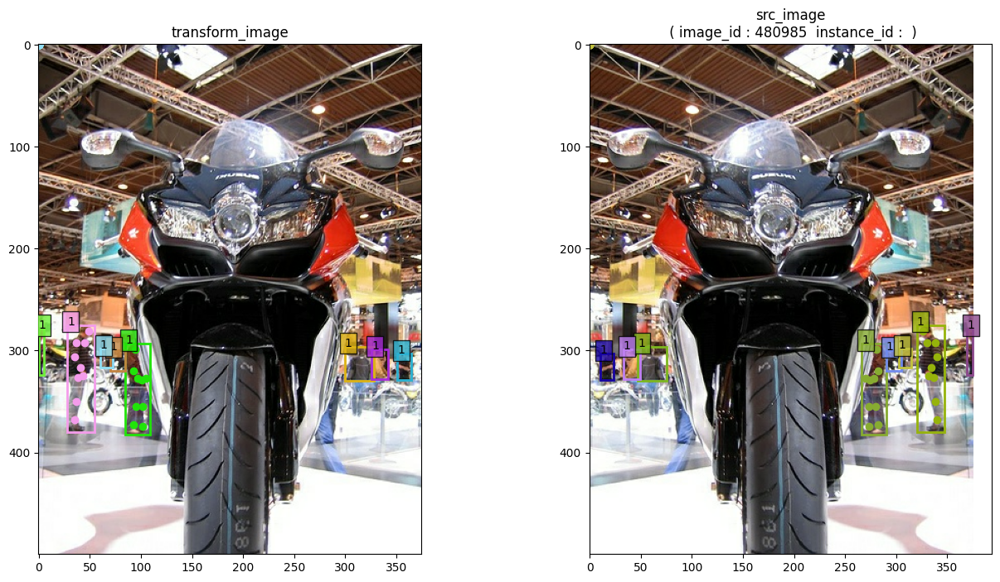

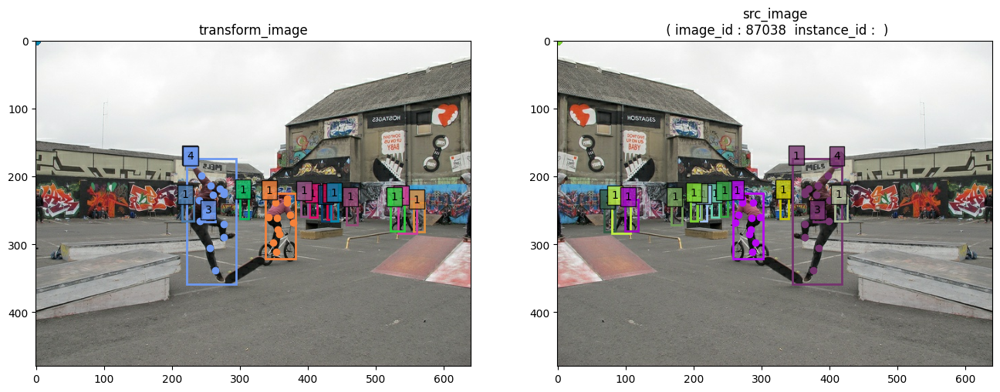

In [8]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)]
)


flip_cfg = dict(
    type='RandomFlip',  
    prob = 1.,      
    kps_index_flip = [0, 2, 1, 4, 3, 6, 5, 8, 7, 10, 9, 12, 11, 14, 13, 16, 15],  
    #labels_flip  = {1:1, 2:2, 3:4, 4:3} 
) 


dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [flip_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0],
        plot_transformed_bbox=True,
    )
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
#get batch_dataset here!!!!!!
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
'JUST TO REVIEW PIPELINE'
tfds_builder.get_pipeline_cfg() 
'JUST TO REVIEW TRANSFORM RESESULTS'
tfds_builder.explore_samples(
    take_batch_num = 2,
    test_mode  = True
)

In [41]:
tfds_builder.execution_time(take_batch_num=10)

2024-04-12 22:37:30.888794: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_21' with dtype int64
	 [[{{node Placeholder/_21}}]]
2024-04-12 22:37:30.889196: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_21' with dtype int64
	 [[{{node Placeholder/_21}}]]


avg execution time (s): 0.2821199


### **<font size="5">`b. MixUp (optinal)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- Mosaic : <lib.datasets.transforms.mosaic.Mosaic object at 0x7fec814587c0>
< 2 >  --- RandomMixUp : <lib.datasets.transforms.random_mixup.RandomMixUp object at 0x7feca1196640>
--------------------------------------------------------------------------------


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- Mosaic : <lib.datasets.transforms.mosaic.Mosaic object at 0x7fec814587c0>
< 2 >  --- RandomMixUp : <lib.datasets.transforms.random_mixup.RandomMixUp object at 0x7feca1196640>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets

2024-04-15 13:16:50.308516: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_20' with dtype float and shape [2]
	 [[{{node Placeholder/_20}}]]
2024-04-15 13:16:50.308897: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- TensorSpec(shape=(16, 640, 640, 3), dtype=tf.uint8, name=None)
kpts ----- RaggedTensorSpec(TensorShape([16, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([16, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([16, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([16, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([16, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([16, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(16,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([16, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([16, None, 17, 3]), tf.float32, 1, tf.int64)


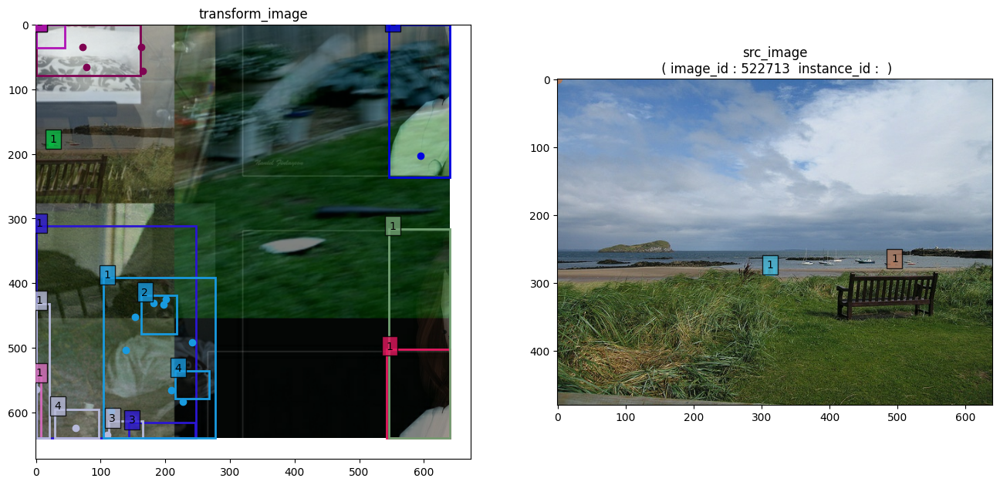

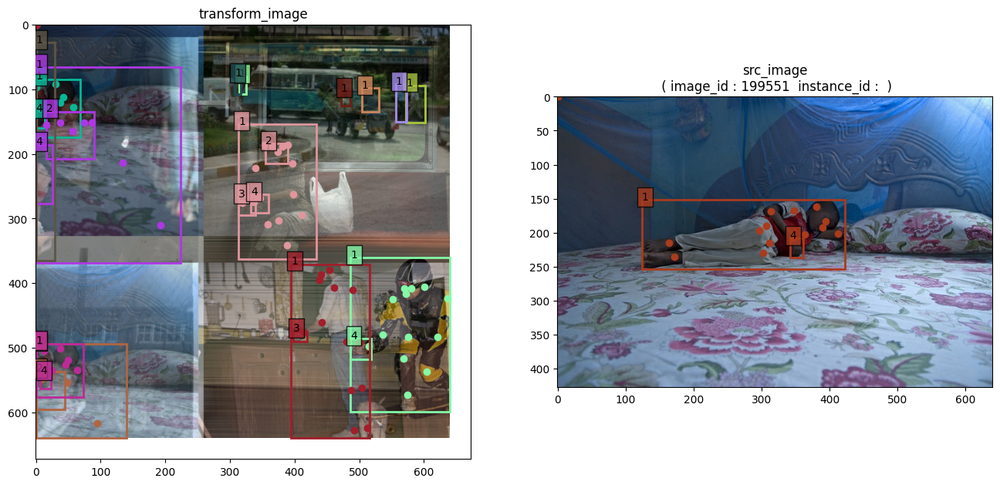

In [7]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)],
    pose_style = 'coco'
)

mosaic_cfg = dict( 
    type = 'Mosaic',
    target_size = (640,640),
    interpolation = 'bilinear',
    center_ratio_range = (0.75, 1.25),
    scaling_ratio_range= (0.75, 1.25),
    num_used_kps = 17,
    img_padding_val = 0,
    label_padding_val =  0,
    pose_obj_label_id  = 1,
    min_bbox_area = 0., #4096./2,
    use_affine_transform= True,
    prob = 1.
)
mixup_cfg = dict( 
    type = 'RandomMixUp',
    alpha = 0.,
    prob = 1.
)
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 16,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [mosaic_cfg, mixup_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0],
        plot_transformed_bbox=True,
    )
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)


tfds_builder.get_pipeline_cfg() 

tfds_builder.explore_samples(
    take_batch_num = 2,

)

### **<font size="5">`c. RandomHalfBody (topdown only)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

samples_in_tfrec : 1880 @ <file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomHalfBody : <lib.datasets.transforms.random_half_body.RandomHalfBody object at 0x7ff702ae8340>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7ff702ac59d0>
--------------------------------------------------------------------------------



2024-04-15 12:46:52.593600: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_20' with dtype int32 and shape [9]
	 [[{{node Placeholder/_20}}]]
2024-04-15 12:46:52.594012: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_20' with dtype int32 and shape [9]
	 [[{{node Placeholder/_20}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- TensorSpec(shape=(4, 17, 3), dtype=tf.float32, name=None)
bboxes ----- TensorSpec(shape=(4, 4), dtype=tf.float32, name=None)
labels ----- None
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- TensorSpec(shape=(4, 4), dtype=tf.float32, name=None)
src_labels ----- None
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_kpts ----- TensorSpec(shape=(4, 17, 3), dtype=tf.float32, name=None)


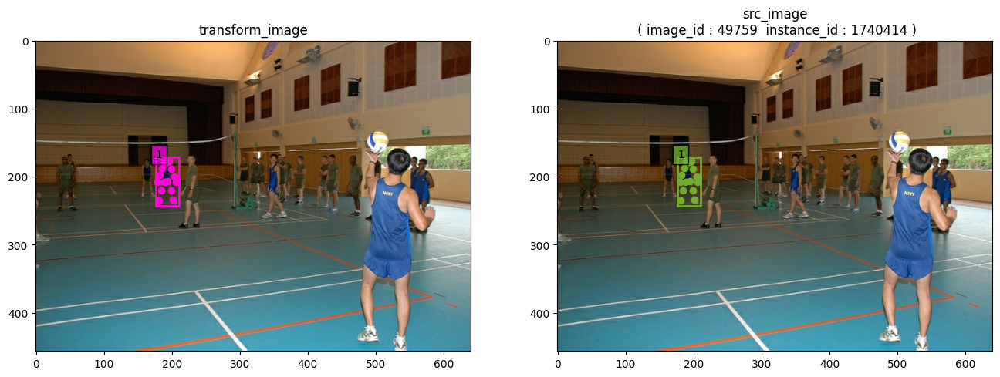

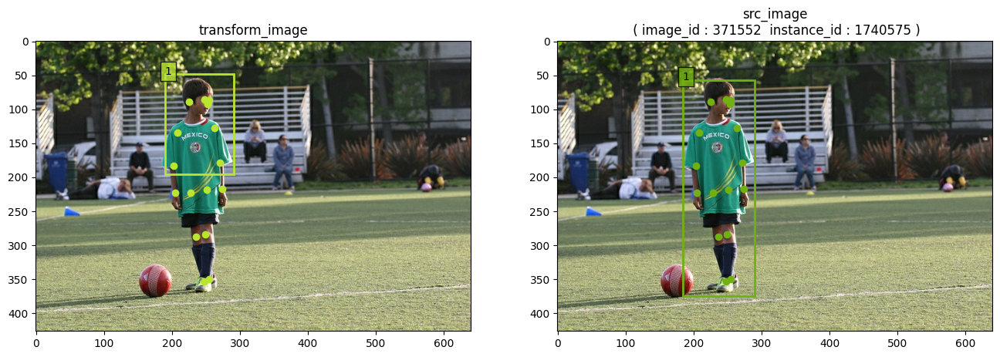

In [8]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoSinglePoseTFRec', 
    data_root = val_sp_tfrec_dir
)
halfbody_cfg = dict(
    type='RandomHalfBody',
    prob=1.0, 
    upper_prioritized_prob= 1.,
    padding = 1.5,
    min_total_keypoints = 9, 
    min_upper_keypoints = 4,
    min_lower_keypoints = 4,
    test_mode = True
)
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [halfbody_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)  
tfds_builder = DATASETS.build(copy.deepcopy(dataloader_cfg))

batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)

tfds_builder.explore_samples(
    take_batch_num = 2,
    test_mode  = True
)

### **<font size="5">`d. RandomBBoxTransform (topdown only)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

samples_in_tfrec : 1880 @ <file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomBBoxTransform : <lib.datasets.transforms.random_bbox_transform.RandomBBoxTransform object at 0x7faed0fecd60>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7faee27aeca0>
--------------------------------------------------------------------------------



2024-04-14 14:52:11.409199: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]
2024-04-14 14:52:11.409542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- TensorSpec(shape=(4, 17, 3), dtype=tf.float32, name=None)
bboxes ----- TensorSpec(shape=(4, 4), dtype=tf.float32, name=None)
labels ----- None
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- TensorSpec(shape=(4, 4), dtype=tf.float32, name=None)
src_labels ----- None
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_kpts ----- TensorSpec(shape=(4, 17, 3), dtype=tf.float32, name=None)


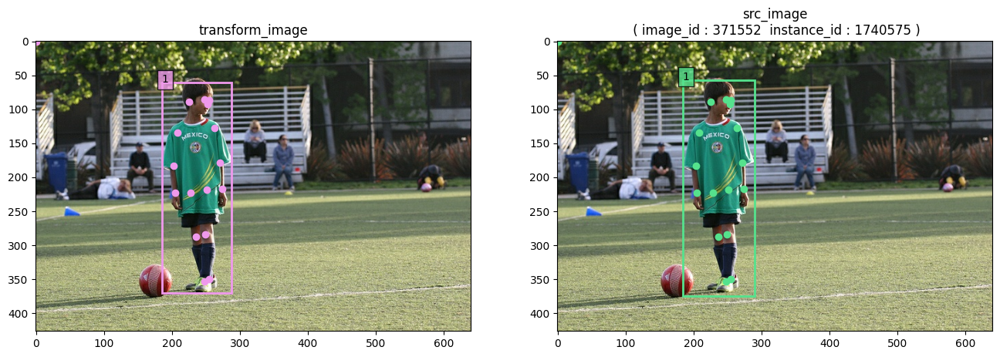

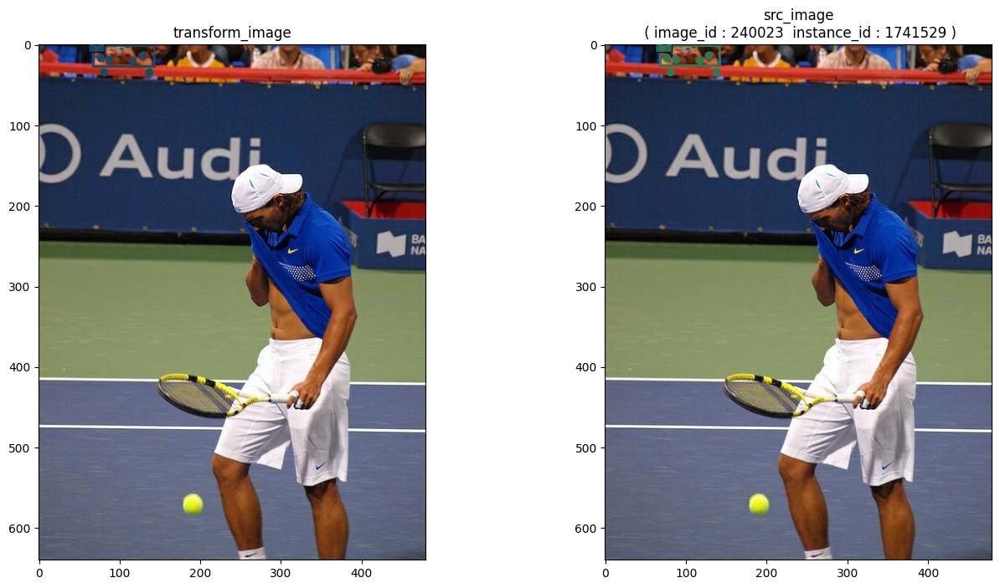

In [9]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoSinglePoseTFRec', 
    data_root = val_sp_tfrec_dir
)
bbox_cfg = dict(
    type='RandomBBoxTransform',  
    shift_factor = 0.16, 
    shift_prob = 1., 
    scale_factor = (0.75, 1.25), 
    scale_prob = 1. ,
    test_mode = False
)
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [bbox_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)
#--------------------------------------------------------------     
tfds_builder = DATASETS.build(copy.deepcopy(dataloader_cfg))
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)

tfds_builder.explore_samples(
    take_batch_num = 2,
    test_mode  = True
)

### **<font size="5">`e. RandomKPSDropout (to do support bottomup) `</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val

samples_in_tfrec : 1880 @ <file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_kps_val



2024-04-13 09:54:13.119241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'map/while/cond/cond/cond/cond_1/ones/map/while/cond/cond/strided_slice' with dtype int32 and shape [2]
	 [[{{node map/while/cond/cond/cond/cond_1/ones/map/while/cond/cond/strided_slice}}]]
2024-04-13 09:54:13.119317: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'map/while/cond/cond/cond/cond_1/ones/map/while/cond/cond/strided_slice' with dtype int32 and shape [2]
	 [[{{node map/while/cond/cond/cond/cond_1/ones/map/while/cond/cond/strided_slice}}]]



 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomCutoutByKeypoints : <lib.datasets.transforms.random_cutout_by_kps.RandomCutoutByKeypoints object at 0x7fbbf100e9a0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fbb28177b80>
--------------------------------------------------------------------------------



2024-04-13 09:54:13.564067: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]
2024-04-13 09:54:13.564418: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [3]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- TensorSpec(shape=(4, 17, 3), dtype=tf.float32, name=None)
bboxes ----- TensorSpec(shape=(4, 4), dtype=tf.float32, name=None)
labels ----- None
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- TensorSpec(shape=(4, 4), dtype=tf.float32, name=None)
src_labels ----- None
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_kpts ----- TensorSpec(shape=(4, 17, 3), dtype=tf.float32, name=None)


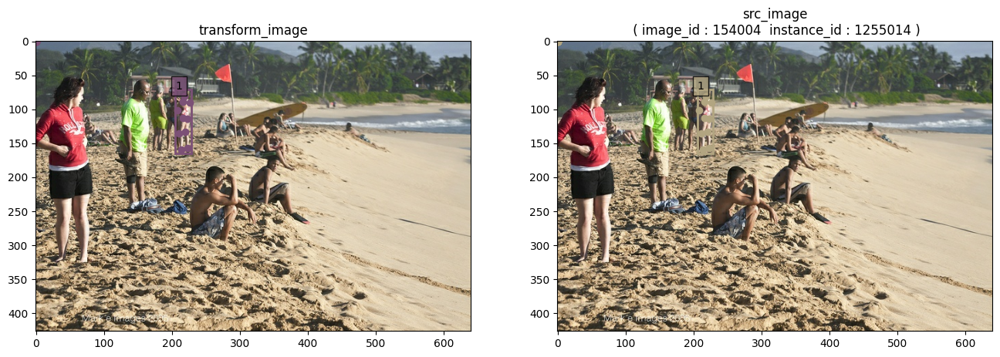

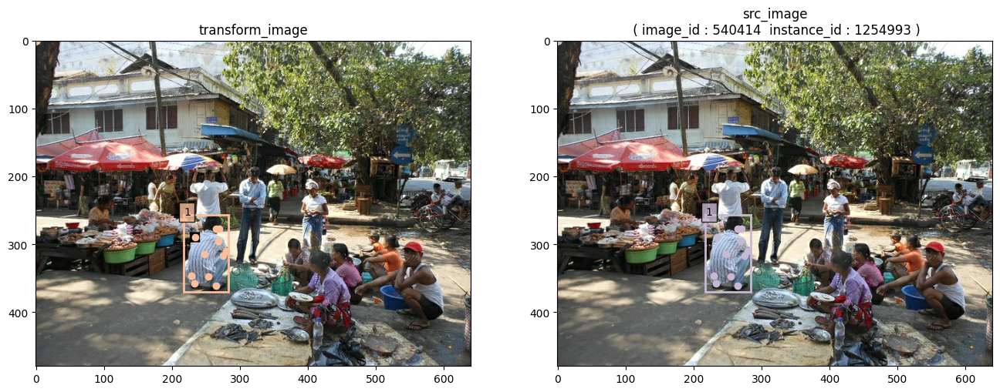

In [17]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoSinglePoseTFRec', 
    data_root = val_sp_tfrec_dir
)
kps_dropout = dict(
    type = 'RandomCutoutByKeypoints',
    base_mask_ratio = 0.05,
    mask_scale_factor = (0.8, 1.2),
    min_bbox_area = 64.*64.,
    prob=1.0, 
    drop_joints_indices=[5,6,7,8,11,12],
    random_mask_color=False, 
    test_mode =False
)
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [kps_dropout],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)
#--------------------------------------------------------------     
tfds_builder = DATASETS.build(copy.deepcopy(dataloader_cfg))
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)

tfds_builder.explore_samples(
    take_batch_num = 2,
    test_mode  = True
)

successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val

samples_in_tfrec : 1880 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val

==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
src_image ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_height ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_width ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_keypoints ----- RaggedTensorSpec(TensorShape([4, None]), tf.float32, 1, tf.int64)
src_bbox ----- TensorSpec(shape=(4, 4), dtype=tf.float32, name=None)
src_num_keypoints

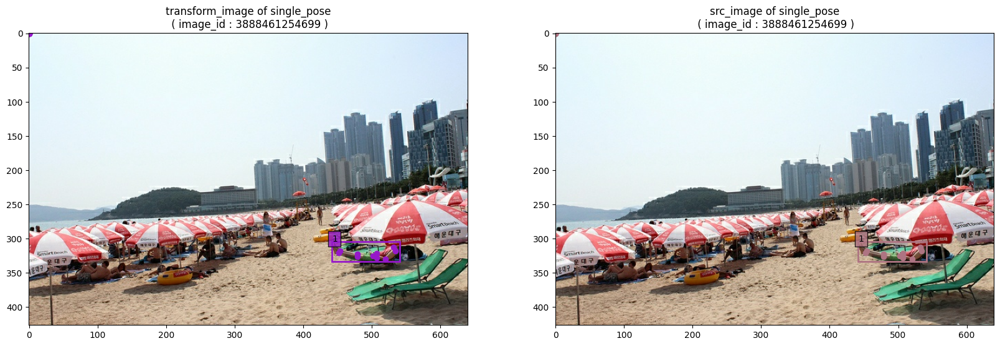

In [18]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoSinglePoseTFRec_CocoPoseStyle', 
    data_root = val_sp_tfrec_dir,
)

# tfrec_val_dataset = dict(
#     type = 'Parser_CocoMultiPoseTFRec_CocoPoseStyle', 
#     data_root = val_mp_tfrec_dir,
#     is_whole_body_boxes = True,
#     sel_kpt_idx  = [i for i in range(17)],
# )

kpsdrop_cfg = dict(
    type='RandomKPSDropout',   
    base_mask_ratio = 0.05,
    mask_scale_factor = (0.8, 1.2),
    min_bbox_area = 64.*64.,
    prob=1.0, 
    drop_joints_indices=[5,6,7,8,11,12],
    random_mask_color=False, 
    test_mode =False
)

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [kpsdrop_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None
)
#--------------------------------------------------------------     
tfds_builder = DATASETS.build(copy.deepcopy(dataloader_cfg))
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
#--------------------------------------------------------------    
Vis_PoseSampleTransform(
    samples = next(iter(batch_dataset)),   
    batch_id  =0,
)




### **<font size="5">`f. RandomHSVAug (image)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomHSVAug : <lib.datasets.transforms.random_hsv.RandomHSVAug object at 0x7fbc11fb1e80>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fbc4246e4c0>
--------------------------------------------------------------------------------



2024-04-13 09:54:18.747347: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-13 09:54:18.747697: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)


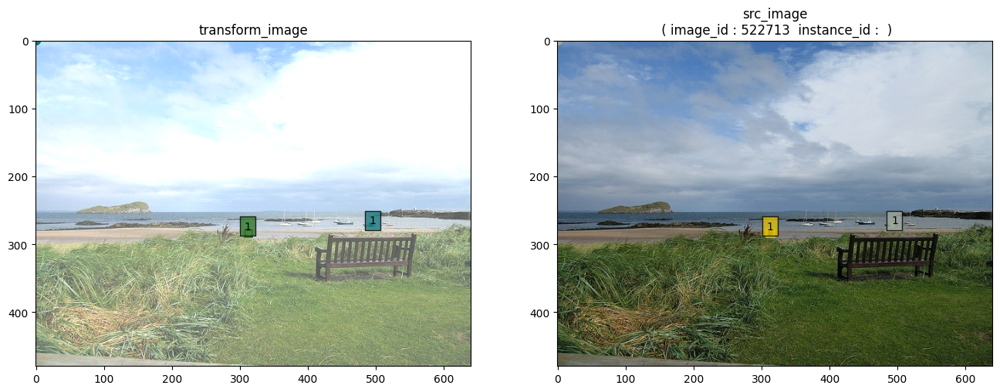

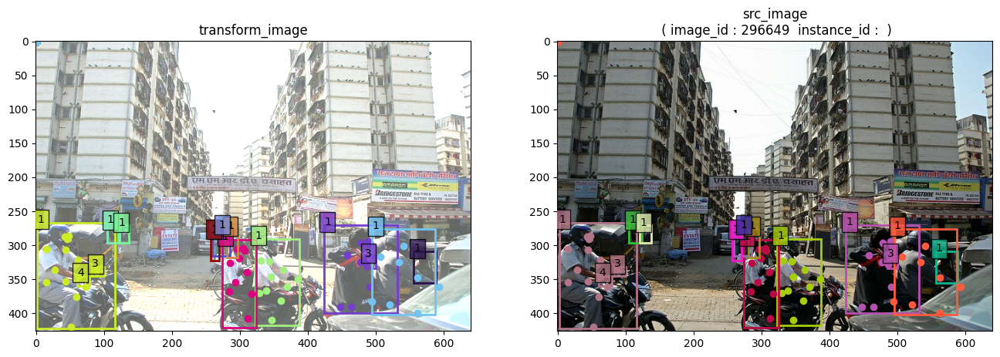

In [18]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)]
)
hsv_cfg = dict(
    type='RandomHSVAug',  
    hue_prob = 0.5,
    saturation_prob = 0.5,
    brightness_prob = 0.5,
    hue_delta = 0.3, 
    saturation_factor = (0.5,2.0),
    brightness_delta = 0.4
)
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [hsv_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
)
tfds_builder = DATASETS.build(copy.deepcopy(dataloader_cfg))
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
#--------------------------------------------------------------    
tfds_builder.explore_samples(
    take_batch_num = 2,
)


### **<font size="5">`g. RandomGaussianBlur (iamge)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomGaussianBlur : <lib.datasets.transforms.random_gaussian_blur.RandomGaussianBlur object at 0x7fbb28125ca0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fbc423a1ca0>
--------------------------------------------------------------------------------



2024-04-13 09:54:26.973940: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-13 09:54:26.974352: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)


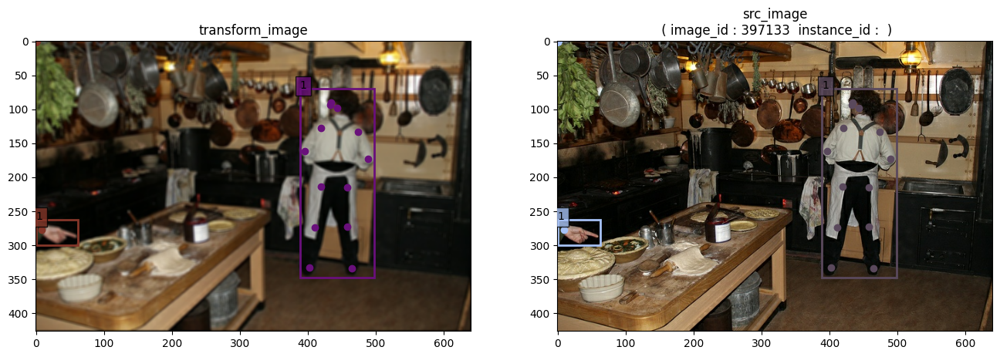

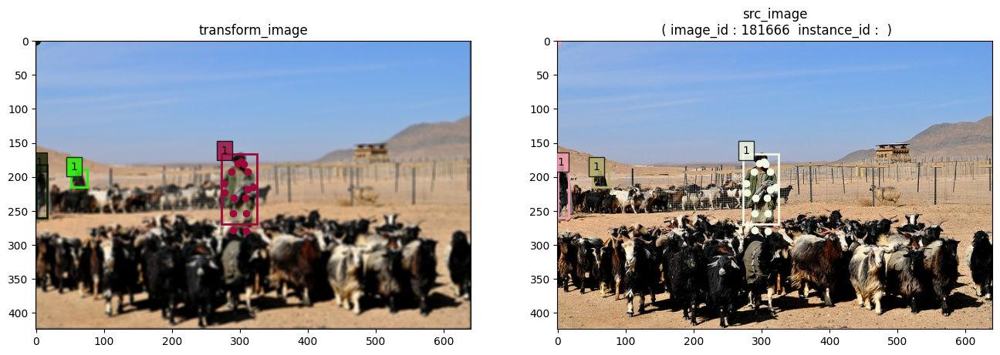

In [19]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)]
)
blur_cfg = dict(
    type='RandomGaussianBlur', 
    kernel_size_xy=(5,5),
    factor=3.0,
    prob =1.,
    test_mode=True
)

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [blur_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
    
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)

#--------------------------------------------------------------    
tfds_builder.explore_samples(
    take_batch_num = 2
)

### **<font size="5">`i. RandomContrast (iamge)`</font>**

/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:92: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(


successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val



/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.4/lib/datasets/tfds_builder.py:260: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")
2024-04-15 15:24:55.617778: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-15 15:24:55.618123: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomContrast : <lib.datasets.transforms.random_contrast.RandomContrast object at 0x7f7bb9b94c10>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7f7b898da5e0>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorSh

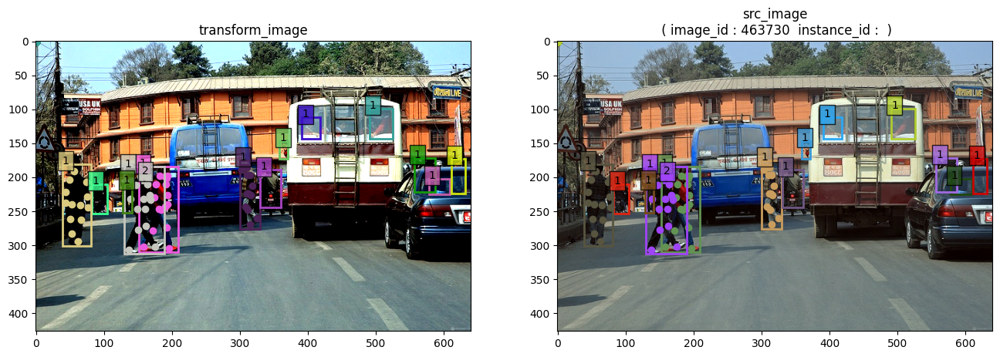

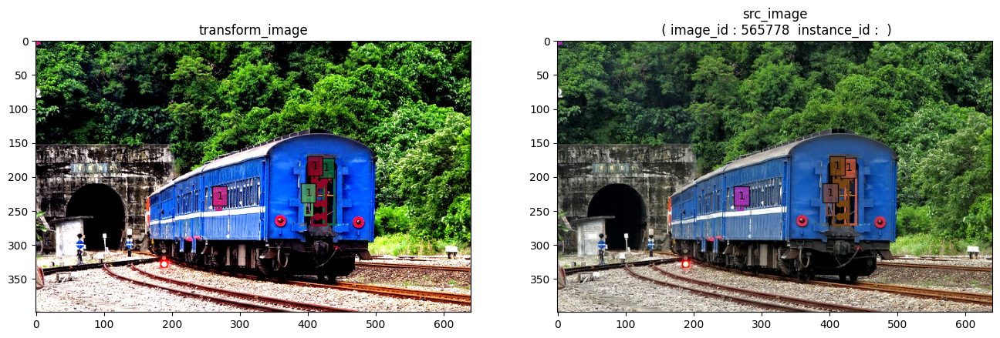

In [12]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)]
)
contrast_cfg = dict(
    type = 'RandomContrast',
    value_range =(0,255), 
    factor =(0.3, 0.8),
    prob = 1.,
    test_mode=True
)  
dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [contrast_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
    
)
#--------------------------------------------------------------     
tfds_builder = DATASETS.build(copy.deepcopy(dataloader_cfg))
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
#--------------------------------------------------------------    
tfds_builder.explore_samples(
    take_batch_num = 2
)

### **<font size="5">`j. RandomChannelShift (image)`</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomChannelShift : <lib.datasets.transforms.random_channel_shift.RandomChannelShift object at 0x7fbc11f590a0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fbbd0ab9790>
--------------------------------------------------------------------------------



2024-04-13 09:55:13.233627: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-13 09:55:13.234011: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)


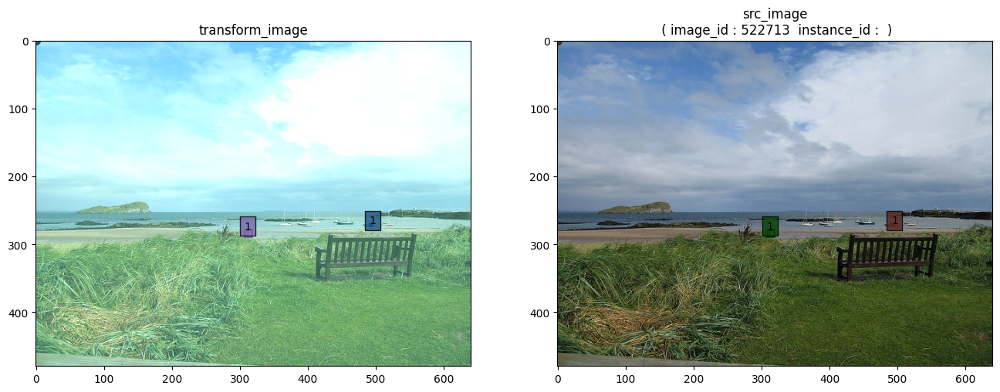

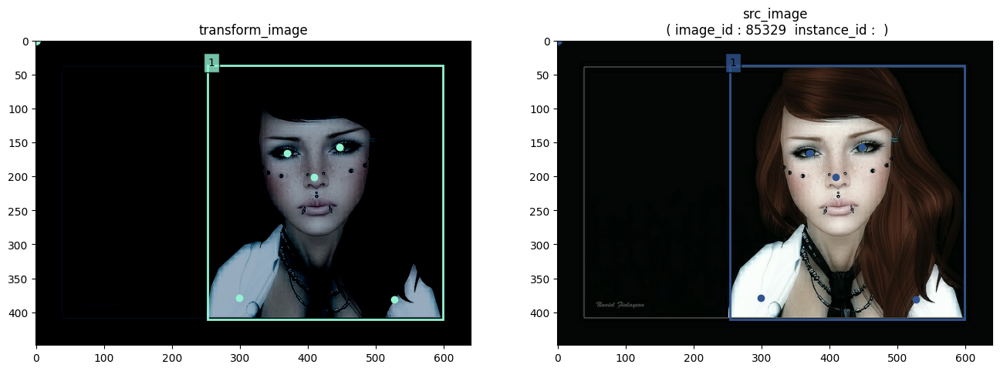

In [22]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)]
)

ChannelShift_cfg = dict(
    type = 'RandomChannelShift',
    value_range =(0,255), 
    factor =(0.3,0.8),
    prob = 1.,
    test_mode=False
)

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [ChannelShift_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
    
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
#--------------------------------------------------------------    
tfds_builder.explore_samples(
    take_batch_num = 2
)

### **<font size="5">`k. Idendity `</font>**

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- Idendity : <lib.datasets.transforms.idendity.Idendity object at 0x7fad610ca2b0>
< 2 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7fad50675550>
--------------------------------------------------------------------------------



2024-04-13 14:14:12.307151: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-13 14:14:12.307501: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]



==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)
bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
src_img_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_ids ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
src_kpts ----- RaggedTensorSpec(TensorShape([4, None, 17, 3]), tf.float32, 1, tf.int64)


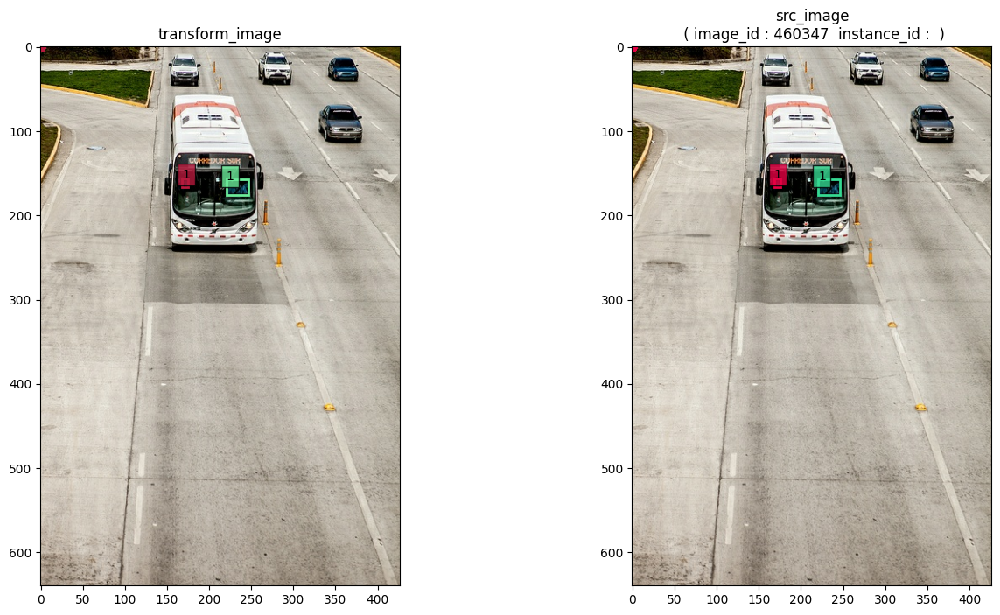

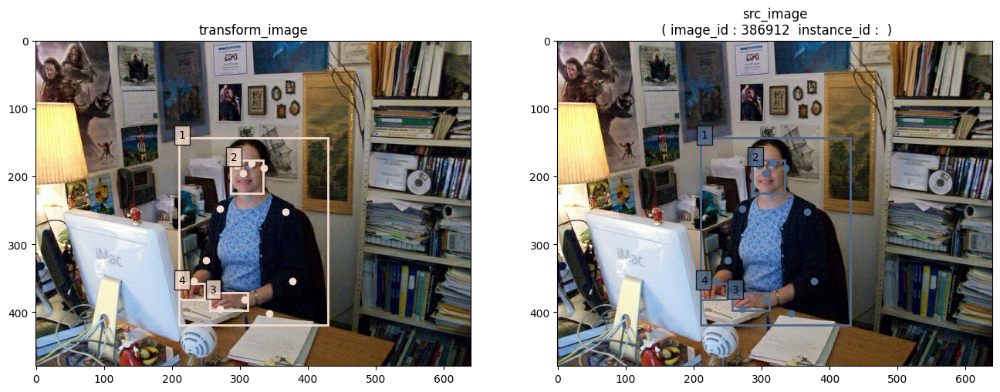

In [6]:
tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)]
)

IdendityTest = dict(type='VectorizedIdendity')
IdendityTest = dict(type='Idendity')
#IdendityTest = Idendity()

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [IdendityTest],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
    
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
#--------------------------------------------------------------    
tfds_builder.explore_samples(
    take_batch_num = 2
)

### **<font size="5">`k. EnsureTensor `</font>**

In [8]:

tfrec_val_dataset = dict(
    type = 'Parser_CocoMultiPoseTFRec', 
    data_root = val_mp_tfrec_dir,
    is_whole_body_boxes = True,
    sel_kpt_idx  =[i for i in range(17)]
)

EnsureTensor_cfg = dict(type='EnsureTensor')

dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = 4,
    prefetch_size = 4,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_val_dataset],
    augmenters = [EnsureTensor_cfg],  #[IdendityTest_cfg , mosaic]
    codec = None,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0]
    )
    
)
tfds_builder = DATASETS.build(
    copy.deepcopy(dataloader_cfg)
)
batch_dataset = tfds_builder.GenerateTargets(
    test_mode=True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
#--------------------------------------------------------------    
# tfds_builder.explore_samples(
#     take_batch_num = 2
# )

for sample in batch_dataset.take(1):
    print(type(sample))
    PackInputTensorTypeSpec(sample, {})

successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

samples_in_tfrec : 2693 @ <file_00-2693.tfrec>
num_TotalSamples: 2693
successfully connect floder  : 
/Volumes/Extreme Pro/deep_learning/ML_DataSet/COCO-WholeBody/tfrecords_multi_poses_val

<class 'dict'>

==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
src_image ----- RaggedTensorSpec(TensorShape([4, None, None, 3]), tf.uint8, 2, tf.int64)
src_height ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_width ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
src_bbox ----- RaggedTensorSpec(TensorShape([4, None, 4]), tf.float32, 1, tf.int64)
area ----- RaggedTensorSpec(TensorShape([4, None]), tf.float32, 1, tf.int64)
src_labels ----- RaggedTensorSpec(TensorShape([4, None]), tf.int32, 1, tf.int64)
id ----- RaggedTensorSpec(TensorShape([4, None]), tf.int64, 1, tf.int64)
image_id ----- TensorSpec(shape=(4,), dtype=tf.int64, name=None)
i

2024-04-13 14:15:10.971555: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-04-13 14:15:10.971895: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
